<a href="https://colab.research.google.com/github/weswest/MSDS453/blob/main/MSDS453_A1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0 Setup

## 0.1 TA-Provided Inputs

In [1]:
import pandas as pd
import os
import numpy as np
import re
import string
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
import random
from dataclasses import dataclass

from nltk.stem.wordnet import WordNetLemmatizer
from nltk.stem import PorterStemmer

import gensim
from gensim.models import Word2Vec
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.manifold import TSNE

import scipy.cluster.hierarchy

from IPython.display import display, HTML

from typing import List, Callable, Dict


In [2]:
### Note: code below only needs to be run once

nltk.download('stopwords',quiet=True)
nltk.download('wordnet',quiet=True)
nltk.download('punkt',quiet=True)
nltk.download('omw-1.4',quiet=True)

True

In [3]:
import pkg_resources
#pkg_resources.require("gensim<=3.8.3");
print("Genism Version: ", gensim.__version__)

Genism Version:  4.3.1


In [4]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

## 0.2 Wes-Levered Inputs

In [5]:
import random

random_seed = 453
random.seed(random_seed)
np.random.seed(random_seed)
#tf.random.set_seed(random_seed)

import csv
import pickle
folder = 'train'

## 0.3 Mount GDrive

In [6]:
from google.colab import drive
drive.mount('/content/drive')
try:
  os.chdir("drive/My Drive/MSDS/453/A1")
except:
  pass

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 0.4 TA-Generated Utilities

In [7]:
def add_movie_descriptor(data: pd.DataFrame, corpus_df: pd.DataFrame):
    """
    Adds "Movie Description" to the supplied dataframe, in the form {Genre}_{P|N}_{Movie Title}_{DocID}
    """
    review = np.where(corpus_df['Review Type (pos or neg)'] == 'Positive', 'P', 'N')
    data['Descriptor'] = corpus_df['Genre of Movie'] + '_' + corpus_df['Movie Title'] + '_' + review + '_' + corpus_df['Doc_ID'].astype(str)

def get_corpus_df(path):
    data = pd.read_csv(path, encoding="utf-8")
    add_movie_descriptor(data, data)
    sorted_data = data.sort_values(['Descriptor'])
    indexed_data = sorted_data.set_index(['Doc_ID'])
    indexed_data['Doc_ID'] = indexed_data.index
    return indexed_data

def remove_punctuation(text):
    return re.sub('[^a-zA-Z]', ' ', str(text))

def lower_case(text):
    return text.lower()    

def remove_tags(text):    
    return re.sub("&lt;/?.*?&gt;"," &lt;&gt; ", text)

def remove_special_chars_and_digits(text):
    return re.sub("(\\d|\\W)+"," ", text)

@dataclass
class Document:
    doc_id: str
    text: str

def normalize_document(document: Document) -> Document:
    text = document.text
    text = remove_punctuation(text)
    text = lower_case(text)
    text = remove_tags(text)
    text = remove_special_chars_and_digits(text)
    
    return Document(document.doc_id, text)

def normalize_documents(documents: List[Document]) -> List[Document]:
    """
    Normalizes text for all given documents.
    Removes punctuation, converts to lower case, removes tags and special characters.
    """
    return [normalize_document(x) for x in documents]

@dataclass
class TokenizedDocument:
    doc_id: str
    tokens: List[str]

def tokenize_document(document: Document) -> TokenizedDocument:
    tokens = nltk.word_tokenize(document.text)
    return TokenizedDocument(document.doc_id, tokens)

def tokenize_documents(documents: List[Document]) -> List[TokenizedDocument]:
    return [tokenize_document(x) for x in documents]

def lemmatize(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    lemmatizer = WordNetLemmatizer()
    for document in documents:
        output_tokens = [lemmatizer.lemmatize(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))
        
    return result

def stem(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    stemmer = PorterStemmer()
    for document in documents:
        output_tokens = [stemmer.stem(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))

    return result

def remove_stop_words(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    
    stop_words = set(nltk.corpus.stopwords.words('english')) 
    for document in documents:
        filtered_tokens = [w for w in document.tokens if not w in stop_words]
        result.append(TokenizedDocument(document.doc_id, filtered_tokens))
        
    return result
    
def add_flags(data: pd.DataFrame, batman_doc_ids: List[int], action_doc_ids: List[int]):
    data['is_batman'] = data.index.isin(batman_doc_ids)
    data['is_action'] = data.index.isin(action_doc_ids)
    
def get_all_tokens(documents: List[TokenizedDocument]) -> List[str]:
    tokens = {y for x in documents for y in x.tokens}
    return sorted(list(tokens))

## 0.5 Student-Created Functions

In [8]:
def remove_custom_stop_words(documents: List[TokenizedDocument], custom_words) -> List[TokenizedDocument]:
    result = []
    
    stop_words = custom_words 
    for document in documents:
        filtered_tokens = [w for w in document.tokens if not w in stop_words]
        result.append(TokenizedDocument(document.doc_id, filtered_tokens))
        
    return result

In [9]:
def normalize_word(word):
  word = remove_punctuation(word)
  word = lower_case(word)
  word = remove_tags(word)
  word = remove_special_chars_and_digits(word)
  return word

def lemmatize_word(word):
  lemmatizer = WordNetLemmatizer()
  word = lemmatizer.lemmatize(word)
  return word

def stem_word(word):
  stemmer = PorterStemmer()
  word = stemmer.stem(word)
  return word

def clean_word(word):
  print('Original: ',word)
  word = normalize_word(word)
  print('Normalized: ',word)
  word = lemmatize_word(word)
  print('And lemmatized: ', word)
  word = stem_word(word)
  print('And stemmed: ', word)

test_terms = ['action', 'series', 'money', 'chase', 'Indi2o']

for word in test_terms:
  clean_word(word)

Original:  action
Normalized:  action
And lemmatized:  action
And stemmed:  action
Original:  series
Normalized:  series
And lemmatized:  series
And stemmed:  seri
Original:  money
Normalized:  money
And lemmatized:  money
And stemmed:  money
Original:  chase
Normalized:  chase
And lemmatized:  chase
And stemmed:  chase
Original:  Indi2o
Normalized:  indi o
And lemmatized:  indi o
And stemmed:  indi o


# 1. Load Data and EDA

## 1.1 Load Data

In [10]:
test_path = 'https://raw.githubusercontent.com/barrycforever/MSDS_453_Public/main/MSDS453_ClassCorpus/MSDS453_QA_20220906.csv'
class_path = 'https://raw.githubusercontent.com/barrycforever/MSDS_453_Public/main/MSDS453_ClassCorpus/MSDS453_ClassCorpus_Final_Sec56_v1_20230404.csv'

#CORPUS_PATH = test_path
CORPUS_PATH = class_path

corpus_df = get_corpus_df(CORPUS_PATH)
documents = [Document(x, y) for x, y in zip(corpus_df.Doc_ID, corpus_df.Text)]

## 1.2 EDA

In [11]:
corpus_df.shape
# Expect 190, 9 for the class path

(190, 9)

In [12]:
corpus_df.head(4).T

Doc_ID,191,192,193,194
DSI_Title,TJH_Doc1_Angelhasfallen,TJH_Doc2_Angelhasfallen,TJH_Doc3_Angelhasfallen,TJH_Doc4_Angelhasfallen
Submission File Name,TJH_Doc1_Angelhasfallen,TJH_Doc2_Angelhasfallen,TJH_Doc3_Angelhasfallen,TJH_Doc4_Angelhasfallen
Student Name,TJH,TJH,TJH,TJH
Genre of Movie,Action,Action,Action,Action
Review Type (pos or neg),Negative,Negative,Negative,Negative
Movie Title,Angel has fallen,Angel has fallen,Angel has fallen,Angel has fallen
Text,"The sleepy, dopey action bonanza ""Angel Has Fa...","""Angel Has Fallen"" marks the third time that G...",There comes a time when every action franchise...,Ric Roman Waugh's Angel Has Fallen sees U.S. S...
Descriptor,Action_Angel has fallen_N_191,Action_Angel has fallen_N_192,Action_Angel has fallen_N_193,Action_Angel has fallen_N_194
Doc_ID,191,192,193,194


In [13]:
print(corpus_df.info());

<class 'pandas.core.frame.DataFrame'>
Int64Index: 190 entries, 191 to 225
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   DSI_Title                 190 non-null    object
 1   Submission File Name      190 non-null    object
 2   Student Name              190 non-null    object
 3   Genre of Movie            190 non-null    object
 4   Review Type (pos or neg)  190 non-null    object
 5   Movie Title               190 non-null    object
 6   Text                      190 non-null    object
 7   Descriptor                190 non-null    object
 8   Doc_ID                    190 non-null    int64 
dtypes: int64(1), object(8)
memory usage: 14.8+ KB
None


In [14]:
print(corpus_df['Movie Title'].unique())

['Angel has fallen' 'Inception' 'No time to Die' 'Taken' 'Top Gun'
 'Despicable Me 3' 'Holmes and Watson' 'Lost City' 'The Other Guys'
 'Drag me to hell' 'Fresh' 'It Chapter Two' 'Sinister' 'Us' 'Batman'
 'Equilibrium' 'Minority Report' 'Oblivion' 'Pitch Black']


## 1.2.2 Reviews by Genre

In [15]:
counts_df = corpus_df[['Genre of Movie']].copy()
counts_df['Count'] = 1
counts_df.groupby(['Genre of Movie']).count().reset_index()

,Genre of Movie,Count
0,Action,50
1,Comedy,40
2,Horror,50
3,Sci-Fi,50


# 2. Prepare Data for Analysis

Three forms of data prep:
1. Baseline = tokenization + normalization
2. Partial = token + normal + lemmatization + stop words
3. Full = token + normal + lemma + stop words + stems + custom stop words

Recall that:
* Normalization standardizes the text (remove capitals, punctuation, etc)
* Tokenization at the word level splits each word into its own unit
* Lemmatization standardizes words into roots ("bats"-->"bat", "feet"-->"foot")
* Stop words removes common words like "the".  These are boring
* Custom stop words are corpus-specific, like "film" or "movie"
* Removing non-alphabetic tokens strips out numbers

### Steps here:

Just follow each of these in series.  We will save down each of the three sets as "standard1", "standard2", and "standard3"

## 2.0 Cleaning Functions

In the spirit of working smarter, not harder, I realize that the tfidf functionality provided by the TA takes a cleaning method as an input, rather than an already processed document corpus.  So I'm defining the functions up here so that I can then validate my cleaning methods

In [16]:
custom_stop_words = ['film', 'movie']

In [17]:
"""
def clean_method(documents: List[Document], level = 0, custom_stop_words = []) -> List[TokenizedDocument]:
    
#    1. Baseline = tokenization + normalization
#    2. Partial = token + normal + lemmatization + stop words
#    3. Full = token + normal + lemma + stop words + stems + custom stop words

    methods = []
    if level >= 1:
      methods.extend([(normalize_documents, [documents]), (tokenize_documents, [documents])])
    if level >= 2:
      methods.extend([(lemmatize, [documents]), (remove_stop_words, [documents])])
    if level >= 3:
      methods.extend([(remove_custom_stop_words, [documents, custom_stop_words]), (stem, [documents])])
    
    for method, args in methods:
        documents = method(*args)

    return documents

"""

'\ndef clean_method(documents: List[Document], level = 0, custom_stop_words = []) -> List[TokenizedDocument]:\n    \n#    1. Baseline = tokenization + normalization\n#    2. Partial = token + normal + lemmatization + stop words\n#    3. Full = token + normal + lemma + stop words + stems + custom stop words\n\n    methods = []\n    if level >= 1:\n      methods.extend([(normalize_documents, [documents]), (tokenize_documents, [documents])])\n    if level >= 2:\n      methods.extend([(lemmatize, [documents]), (remove_stop_words, [documents])])\n    if level >= 3:\n      methods.extend([(remove_custom_stop_words, [documents, custom_stop_words]), (stem, [documents])])\n    \n    for method, args in methods:\n        documents = method(*args)\n\n    return documents\n\n'

In [18]:
def clean_method(documents: List[Document]) -> List[TokenizedDocument]:
    """
    Normalizes text, tokenizes, lemmatizes, and removes stop words.
    """
    documents = normalize_documents(documents)
    documents = tokenize_documents(documents)
    documents = lemmatize(documents)
    documents = remove_stop_words(documents)
    documents = stem(documents)
        
    return documents

In [19]:

def clean_method1(documents: List[Document]) -> List[TokenizedDocument]:

    """
    1. Baseline = tokenization + normalization
    2. Partial = token + normal + lemmatization + stop words
    3. Full = token + normal + lemma + stop words + stems + custom stop words
    """
    
    documents = normalize_documents(documents)
    documents = tokenize_documents(documents)
#    documents = lemmatize(documents)
#    documents = remove_stop_words(documents)
#    documents = remove_custom_stop_words(documents, custom_stop_words)
#    documents = stem(documents)
        
    return documents

def clean_method2(documents: List[Document]) -> List[TokenizedDocument]:
    """
    1. Baseline = tokenization + normalization
    2. Partial = token + normal + lemmatization + stop words
    3. Full = token + normal + lemma + stop words + stems + custom stop words
    """
    documents = normalize_documents(documents)
    documents = tokenize_documents(documents)
    documents = remove_stop_words(documents)
    documents = lemmatize(documents)
#    documents = remove_custom_stop_words(documents, custom_stop_words)
#    documents = stem(documents)
        
    return documents

def clean_method3(documents: List[Document]) -> List[TokenizedDocument]:
    """
    1. Baseline = tokenization + normalization
    2. Partial = token + normal + lemmatization + stop words
    3. Full = token + normal + lemma + stop words + stems + custom stop words
    """
    documents = normalize_documents(documents)
    documents = tokenize_documents(documents)
    documents = remove_stop_words(documents)
    documents = remove_custom_stop_words(documents, custom_stop_words)
    documents = lemmatize(documents)
    documents = stem(documents)
        
    return documents

## 2.1 Normalize and Tokenize

In [20]:
# Normalize

normalized_documents = normalize_documents(documents)
normalized_documents[0]

Document(doc_id=191, text='the sleepy dopey action bonanza angel has fallen is disappointing and not just for the reasons you might expect being the second sequel to olympus has fallen angel has fallen doesn t even have a high bar to clear olympus has fallen was a by the numbers revenge fantasy about ruthless north koreans and emasculated savior thirsty americans that s mostly distinguished by its considerable displays of over the top violence basically america is graphically imperiled for the sake of confirming a slogan coined by then interim president trumbull morgan freeman as a nation we are never stronger than when we are tested olympus has fallen is at the very least a credible survivalist wet dream in that movie america is temporarily made great again but only after the washington monument is toppled the president is tied up and the secretary of defense is punched in the face and kicked in the belly right before she s dragged across the floor as she defiantly screams the pledge 

In [21]:
# Tokenize

tokenized_documents = tokenize_documents(normalized_documents)
tokenized_documents[0]

TokenizedDocument(doc_id=191, tokens=['the', 'sleepy', 'dopey', 'action', 'bonanza', 'angel', 'has', 'fallen', 'is', 'disappointing', 'and', 'not', 'just', 'for', 'the', 'reasons', 'you', 'might', 'expect', 'being', 'the', 'second', 'sequel', 'to', 'olympus', 'has', 'fallen', 'angel', 'has', 'fallen', 'doesn', 't', 'even', 'have', 'a', 'high', 'bar', 'to', 'clear', 'olympus', 'has', 'fallen', 'was', 'a', 'by', 'the', 'numbers', 'revenge', 'fantasy', 'about', 'ruthless', 'north', 'koreans', 'and', 'emasculated', 'savior', 'thirsty', 'americans', 'that', 's', 'mostly', 'distinguished', 'by', 'its', 'considerable', 'displays', 'of', 'over', 'the', 'top', 'violence', 'basically', 'america', 'is', 'graphically', 'imperiled', 'for', 'the', 'sake', 'of', 'confirming', 'a', 'slogan', 'coined', 'by', 'then', 'interim', 'president', 'trumbull', 'morgan', 'freeman', 'as', 'a', 'nation', 'we', 'are', 'never', 'stronger', 'than', 'when', 'we', 'are', 'tested', 'olympus', 'has', 'fallen', 'is', 'at'

In [22]:
clean_method1(documents)[0]

TokenizedDocument(doc_id=191, tokens=['the', 'sleepy', 'dopey', 'action', 'bonanza', 'angel', 'has', 'fallen', 'is', 'disappointing', 'and', 'not', 'just', 'for', 'the', 'reasons', 'you', 'might', 'expect', 'being', 'the', 'second', 'sequel', 'to', 'olympus', 'has', 'fallen', 'angel', 'has', 'fallen', 'doesn', 't', 'even', 'have', 'a', 'high', 'bar', 'to', 'clear', 'olympus', 'has', 'fallen', 'was', 'a', 'by', 'the', 'numbers', 'revenge', 'fantasy', 'about', 'ruthless', 'north', 'koreans', 'and', 'emasculated', 'savior', 'thirsty', 'americans', 'that', 's', 'mostly', 'distinguished', 'by', 'its', 'considerable', 'displays', 'of', 'over', 'the', 'top', 'violence', 'basically', 'america', 'is', 'graphically', 'imperiled', 'for', 'the', 'sake', 'of', 'confirming', 'a', 'slogan', 'coined', 'by', 'then', 'interim', 'president', 'trumbull', 'morgan', 'freeman', 'as', 'a', 'nation', 'we', 'are', 'never', 'stronger', 'than', 'when', 'we', 'are', 'tested', 'olympus', 'has', 'fallen', 'is', 'at'

In [23]:
standard1 = tokenized_documents.copy()

## Lemmatize and Standard Word Remove

In [24]:
lemmatized_documents = lemmatize(tokenized_documents)
lemmatized_documents[0]

TokenizedDocument(doc_id=191, tokens=['the', 'sleepy', 'dopey', 'action', 'bonanza', 'angel', 'ha', 'fallen', 'is', 'disappointing', 'and', 'not', 'just', 'for', 'the', 'reason', 'you', 'might', 'expect', 'being', 'the', 'second', 'sequel', 'to', 'olympus', 'ha', 'fallen', 'angel', 'ha', 'fallen', 'doesn', 't', 'even', 'have', 'a', 'high', 'bar', 'to', 'clear', 'olympus', 'ha', 'fallen', 'wa', 'a', 'by', 'the', 'number', 'revenge', 'fantasy', 'about', 'ruthless', 'north', 'korean', 'and', 'emasculated', 'savior', 'thirsty', 'american', 'that', 's', 'mostly', 'distinguished', 'by', 'it', 'considerable', 'display', 'of', 'over', 'the', 'top', 'violence', 'basically', 'america', 'is', 'graphically', 'imperiled', 'for', 'the', 'sake', 'of', 'confirming', 'a', 'slogan', 'coined', 'by', 'then', 'interim', 'president', 'trumbull', 'morgan', 'freeman', 'a', 'a', 'nation', 'we', 'are', 'never', 'stronger', 'than', 'when', 'we', 'are', 'tested', 'olympus', 'ha', 'fallen', 'is', 'at', 'the', 'ver

In [25]:
stopwords_documents = remove_stop_words(lemmatized_documents)
stopwords_documents[0]

TokenizedDocument(doc_id=191, tokens=['sleepy', 'dopey', 'action', 'bonanza', 'angel', 'ha', 'fallen', 'disappointing', 'reason', 'might', 'expect', 'second', 'sequel', 'olympus', 'ha', 'fallen', 'angel', 'ha', 'fallen', 'even', 'high', 'bar', 'clear', 'olympus', 'ha', 'fallen', 'wa', 'number', 'revenge', 'fantasy', 'ruthless', 'north', 'korean', 'emasculated', 'savior', 'thirsty', 'american', 'mostly', 'distinguished', 'considerable', 'display', 'top', 'violence', 'basically', 'america', 'graphically', 'imperiled', 'sake', 'confirming', 'slogan', 'coined', 'interim', 'president', 'trumbull', 'morgan', 'freeman', 'nation', 'never', 'stronger', 'tested', 'olympus', 'ha', 'fallen', 'least', 'credible', 'survivalist', 'wet', 'dream', 'movie', 'america', 'temporarily', 'made', 'great', 'washington', 'monument', 'toppled', 'president', 'tied', 'secretary', 'defense', 'punched', 'face', 'kicked', 'belly', 'right', 'dragged', 'across', 'floor', 'defiantly', 'scream', 'pledge', 'allegiance', '

In [26]:
clean_method2(documents)[0]

TokenizedDocument(doc_id=191, tokens=['sleepy', 'dopey', 'action', 'bonanza', 'angel', 'fallen', 'disappointing', 'reason', 'might', 'expect', 'second', 'sequel', 'olympus', 'fallen', 'angel', 'fallen', 'even', 'high', 'bar', 'clear', 'olympus', 'fallen', 'number', 'revenge', 'fantasy', 'ruthless', 'north', 'korean', 'emasculated', 'savior', 'thirsty', 'american', 'mostly', 'distinguished', 'considerable', 'display', 'top', 'violence', 'basically', 'america', 'graphically', 'imperiled', 'sake', 'confirming', 'slogan', 'coined', 'interim', 'president', 'trumbull', 'morgan', 'freeman', 'nation', 'never', 'stronger', 'tested', 'olympus', 'fallen', 'least', 'credible', 'survivalist', 'wet', 'dream', 'movie', 'america', 'temporarily', 'made', 'great', 'washington', 'monument', 'toppled', 'president', 'tied', 'secretary', 'defense', 'punched', 'face', 'kicked', 'belly', 'right', 'dragged', 'across', 'floor', 'defiantly', 'scream', 'pledge', 'allegiance', 'defeat', 'north', 'korean', 'banning

In [27]:
standard2 = stopwords_documents.copy()

## 2.3.1 Remove Custom Stopwords

Note: the removing custom stop words needs to go up ahead of the stemmed pull.  So this code is inefficient in that it requires stemming twice.  C'est la vie

In [28]:

custom_stop_words_documents = remove_custom_stop_words(stopwords_documents, custom_stop_words)
custom_stem_documents = stem(custom_stop_words_documents)
custom_stem_documents[0]

TokenizedDocument(doc_id=191, tokens=['sleepi', 'dopey', 'action', 'bonanza', 'angel', 'ha', 'fallen', 'disappoint', 'reason', 'might', 'expect', 'second', 'sequel', 'olympu', 'ha', 'fallen', 'angel', 'ha', 'fallen', 'even', 'high', 'bar', 'clear', 'olympu', 'ha', 'fallen', 'wa', 'number', 'reveng', 'fantasi', 'ruthless', 'north', 'korean', 'emascul', 'savior', 'thirsti', 'american', 'mostli', 'distinguish', 'consider', 'display', 'top', 'violenc', 'basic', 'america', 'graphic', 'imperil', 'sake', 'confirm', 'slogan', 'coin', 'interim', 'presid', 'trumbul', 'morgan', 'freeman', 'nation', 'never', 'stronger', 'test', 'olympu', 'ha', 'fallen', 'least', 'credibl', 'survivalist', 'wet', 'dream', 'america', 'temporarili', 'made', 'great', 'washington', 'monument', 'toppl', 'presid', 'tie', 'secretari', 'defens', 'punch', 'face', 'kick', 'belli', 'right', 'drag', 'across', 'floor', 'defiantli', 'scream', 'pledg', 'allegi', 'defeat', 'north', 'korean', 'ban', 'doe', 'offici', 'sanction', 'u',

In [29]:
clean_method3(documents)[0]

TokenizedDocument(doc_id=191, tokens=['sleepi', 'dopey', 'action', 'bonanza', 'angel', 'fallen', 'disappoint', 'reason', 'might', 'expect', 'second', 'sequel', 'olympu', 'fallen', 'angel', 'fallen', 'even', 'high', 'bar', 'clear', 'olympu', 'fallen', 'number', 'reveng', 'fantasi', 'ruthless', 'north', 'korean', 'emascul', 'savior', 'thirsti', 'american', 'mostli', 'distinguish', 'consider', 'display', 'top', 'violenc', 'basic', 'america', 'graphic', 'imperil', 'sake', 'confirm', 'slogan', 'coin', 'interim', 'presid', 'trumbul', 'morgan', 'freeman', 'nation', 'never', 'stronger', 'test', 'olympu', 'fallen', 'least', 'credibl', 'survivalist', 'wet', 'dream', 'america', 'temporarili', 'made', 'great', 'washington', 'monument', 'toppl', 'presid', 'tie', 'secretari', 'defens', 'punch', 'face', 'kick', 'belli', 'right', 'drag', 'across', 'floor', 'defiantli', 'scream', 'pledg', 'allegi', 'defeat', 'north', 'korean', 'ban', 'offici', 'sanction', 'u', 'agent', 'kill', 'bunch', 'bad', 'guy', 'w

In [30]:
standard3 = custom_stem_documents.copy()

# 3. In Between EDAs

## 3.1 Useful Lookups

Note: the code provided by the TA references Batman which happens to be my movie!  So I'll just go for it

In [31]:
titles_by_doc_ids = {x: y for x, y in zip(corpus_df['Doc_ID'], corpus_df['Movie Title'])}
genres_by_doc_ids = {x: y for x, y in zip(corpus_df['Doc_ID'], corpus_df['Genre of Movie'])}
descriptors_by_doc_ids = {x: y for x, y in zip(corpus_df['Doc_ID'], corpus_df['Descriptor'])}

action_doc_ids = [int(x) for x in corpus_df['Doc_ID'] if genres_by_doc_ids[x] == 'Action']
action_documents = [x for x in documents if x.doc_id in action_doc_ids]

non_action_doc_ids = {int(x) for x in corpus_df['Doc_ID'] if genres_by_doc_ids[x] != 'Action'}
non_action_documents = [x for x in documents if x.doc_id in non_action_doc_ids]

## 3.2 Specific Lookups

In [32]:
print(corpus_df['Movie Title'].unique())

['Angel has fallen' 'Inception' 'No time to Die' 'Taken' 'Top Gun'
 'Despicable Me 3' 'Holmes and Watson' 'Lost City' 'The Other Guys'
 'Drag me to hell' 'Fresh' 'It Chapter Two' 'Sinister' 'Us' 'Batman'
 'Equilibrium' 'Minority Report' 'Oblivion' 'Pitch Black']


In [33]:
batman_doc_ids = [int(x) for x in corpus_df['Doc_ID'] if titles_by_doc_ids[x] == 'Batman']
batman_documents = [x for x in documents if x.doc_id in batman_doc_ids]

## 3.3 Qualitative Term Considerations

In [34]:
candidate_terms = [
    'action',
    'sequence',
    'grit',
    'plot',
    'chase',
    'airline',
    'stock',
    'series',
    'effect',
    'strong',
    'theme',
    'character',
    'money',
    'spy',
    'batman',
    'wayne',
    'knight',
    'gotham'
]

# 4. CountVectorizer Work

Note: this uses the normalized documents

In [35]:
vectorizer = CountVectorizer(ngram_range=(1, 1))
text_for_counts = [x.text for x in normalized_documents]
matrix = vectorizer.fit_transform(text_for_counts)
words = vectorizer.get_feature_names_out()
word_counts = pd.DataFrame(matrix.toarray(), columns=words, index=corpus_df.Doc_ID)

In [36]:
add_flags(word_counts, batman_doc_ids, action_doc_ids)
word_counts['Doc_ID'] = word_counts.index

In [37]:
# Collect result into a dataframe
mean_frequencies = pd.DataFrame(index=candidate_terms)

batman_mean_frequencies = word_counts[word_counts.is_batman][[x for x in candidate_terms if x in word_counts.columns]].mean()
mean_frequencies['Batman'] = batman_mean_frequencies

action_mean_frequencies = word_counts[word_counts.is_action][[x for x in candidate_terms if x in word_counts.columns]].mean()
mean_frequencies['All Action'] = action_mean_frequencies

non_action_mean_frequencies = word_counts[~word_counts.is_action][[x for x in candidate_terms if x in word_counts.columns]].mean()
mean_frequencies['All Non-Action'] = non_action_mean_frequencies

In [38]:
mean_frequencies.fillna(0.0).sort_values(['Batman'], ascending=False)

,Batman,All Action,All Non-Action
batman,9.2,0.16,0.664286
gotham,1.7,0.02,0.121429
wayne,1.3,0.04,0.092857
knight,1.1,0.16,0.078571
series,0.8,0.36,0.278571
character,0.7,0.28,0.521429
plot,0.4,0.26,0.485714
theme,0.4,0.02,0.071429
sequence,0.2,0.14,0.121429
action,0.1,1.00,0.500000


In [39]:
# These are identified
important_prevalent_terms = [
    'action',
    'series',
    'chase',
    'wayne',
    'knight',
    'batman',
    'character'
]
stemmer = PorterStemmer()
original_important_prevalent_terms = important_prevalent_terms.copy()
stemmed_important_prevalent_terms = [stemmer.stem(x) for x in important_prevalent_terms]

In [40]:
pd.options.display.float_format = '{:,.2f}'.format
mean_frequencies.fillna(0.0).loc[important_prevalent_terms].round(2).sort_values(['Batman'], ascending=False)

,Batman,All Action,All Non-Action
batman,9.20,0.16,0.66
wayne,1.30,0.04,0.09
knight,1.10,0.16,0.08
series,0.80,0.36,0.28
character,0.70,0.28,0.52
action,0.10,1.00,0.50
chase,0.00,0.10,0.09


# 5. TF-IDF Work

## 5.0 Functions

In [41]:
def run_tfidf(documents: List[Document],
              clean_func: Callable[[List[Document]], List[TokenizedDocument]],
              important_prevalent_terms: List[str],
              experiment_name: str,
              output_tfidf_vectors: bool=False,
              output_vocabulary: bool=True):
    cleaned_documents = clean_func(documents)
    cleaned_document_text = [' '.join(x.tokens) for x in cleaned_documents]
    
    vectorizer = TfidfVectorizer(use_idf=True,
                                 ngram_range=(1, 1),
                                 norm=None)

    transformed_documents = vectorizer.fit_transform(cleaned_document_text)
    transformed_documents_as_array = transformed_documents.toarray()

    output_dir = f'output/{experiment_name}_Results'
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    if output_tfidf_vectors:
        for counter, doc in enumerate(transformed_documents_as_array):
            tf_idf_tuples = list(zip(vectorizer.get_feature_names_out(), doc))
            one_doc_as_df = pd.DataFrame.from_records(tf_idf_tuples, columns=['term', 'score'])\
                                        .sort_values(by='score', ascending=False)\
                                        .reset_index(drop=True)

            one_doc_as_df.to_csv(f'{output_dir}/{corpus_df["Submission File Name"][counter]}')
    
    if output_vocabulary:
        with open(f'{output_dir}/vocabulary.txt', 'w') as vocab:
            words = sorted(vectorizer.get_feature_names_out())
            print('\n'.join(words), file=vocab)

    # Create document-term dataframe
    doc_term_matrix = transformed_documents.todense()
    doc_term_df = pd.DataFrame(doc_term_matrix, 
                               columns=vectorizer.get_feature_names_out(), 
                               index=corpus_df.Doc_ID)
    add_flags(doc_term_df, batman_doc_ids, action_doc_ids)
    
    # Print the top 10 mean TF-IDF values
    top10_tfidf = pd.DataFrame(doc_term_df.mean().sort_values(ascending=False).head(10))
    top10_tfidf.rename(columns={0: 'Mean TF-IDF'}, inplace=True)
    display(top10_tfidf)
    
    # Collect result into a dataframe
    tfidf_results = pd.DataFrame(index=important_prevalent_terms)
 
    all_tfidf_results = doc_term_df[[x for x in important_prevalent_terms if x in doc_term_df.columns]].mean().round(2)
    tfidf_results['All Movies'] = all_tfidf_results
    display(tfidf_results)
    
    plt.hist(doc_term_df.mean(), 100, range=(0, 8))
    
    print(f'Vocabulary size: {doc_term_df.shape[1]}')
    
    descriptors = corpus_df['Descriptor']
       
    similarities = cosine_similarity(doc_term_df.loc[action_doc_ids], doc_term_df.loc[action_doc_ids])
    fig, ax = plt.subplots(figsize=(30, 30))
    labels = [descriptors_by_doc_ids[x.doc_id] for x in action_documents]

#   Note: the code below does a full doc comparison but it crashes the colab run
#   I ran this to get the plots and saved them, then commented it out
#    similarities = cosine_similarity(doc_term_df, doc_term_df)
#    fig, ax = plt.subplots(figsize=(30, 30))
#    labels = [descriptors_by_doc_ids]

    sns.heatmap(ax=ax, data=similarities, xticklabels=labels, yticklabels=labels)
#    plt.savefig(f'figures/{experiment_name}_heatmap_documents.png')
    plt.show()

### 5.1.1 TF-IDF using TA Code

,Mean TF-IDF
film,3.57
movi,3.33
ha,2.43
one,2.41
wa,2.38
like,2.20
ferrel,1.87
time,1.83
batman,1.82
bond,1.81


,All Movies
action,1.28
series,NaN
chase,0.49
wayne,NaN
knight,0.37
batman,1.82
character,0.08


Vocabulary size: 8251


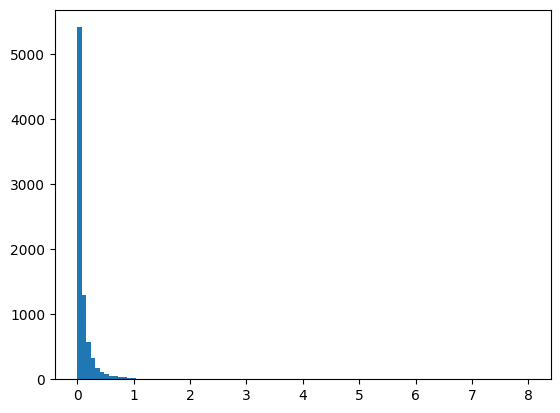

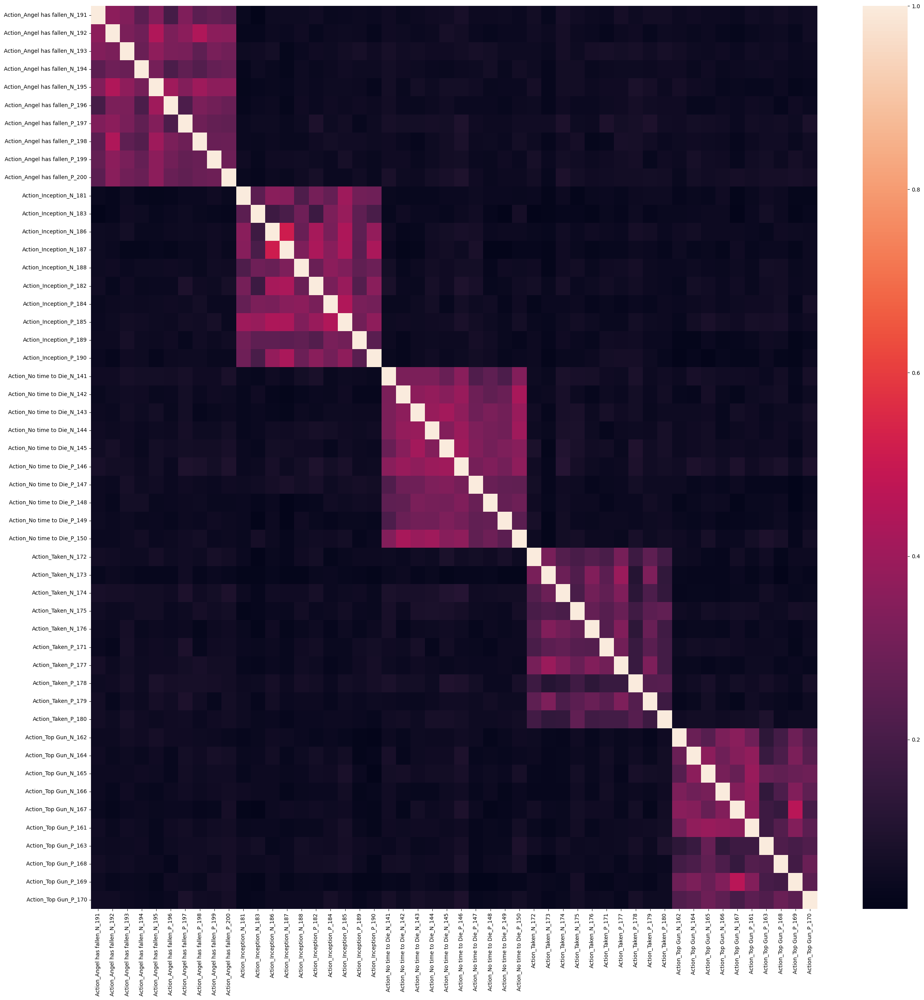

In [42]:
run_tfidf(documents, clean_method, important_prevalent_terms, 'TFIDF_TA')

### 5.1.2 TF-IDF using Clean1

,Mean TF-IDF
the,28.85
and,14.42
of,13.61
to,13.01
in,8.53
is,7.74
that,6.96
it,5.87
with,4.51
as,4.50


,All Movies
action,1.25
series,0.75
chase,0.33
wayne,0.31
knight,0.37
batman,1.79
character,0.97


Vocabulary size: 11946


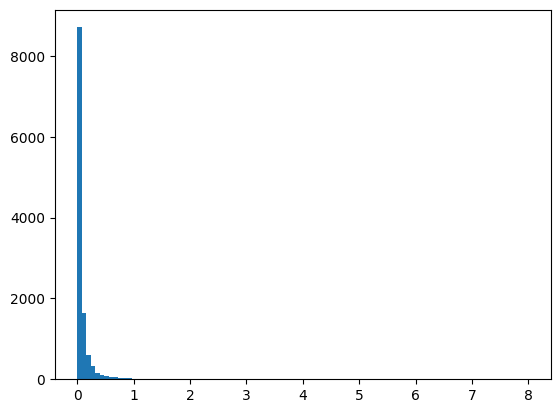

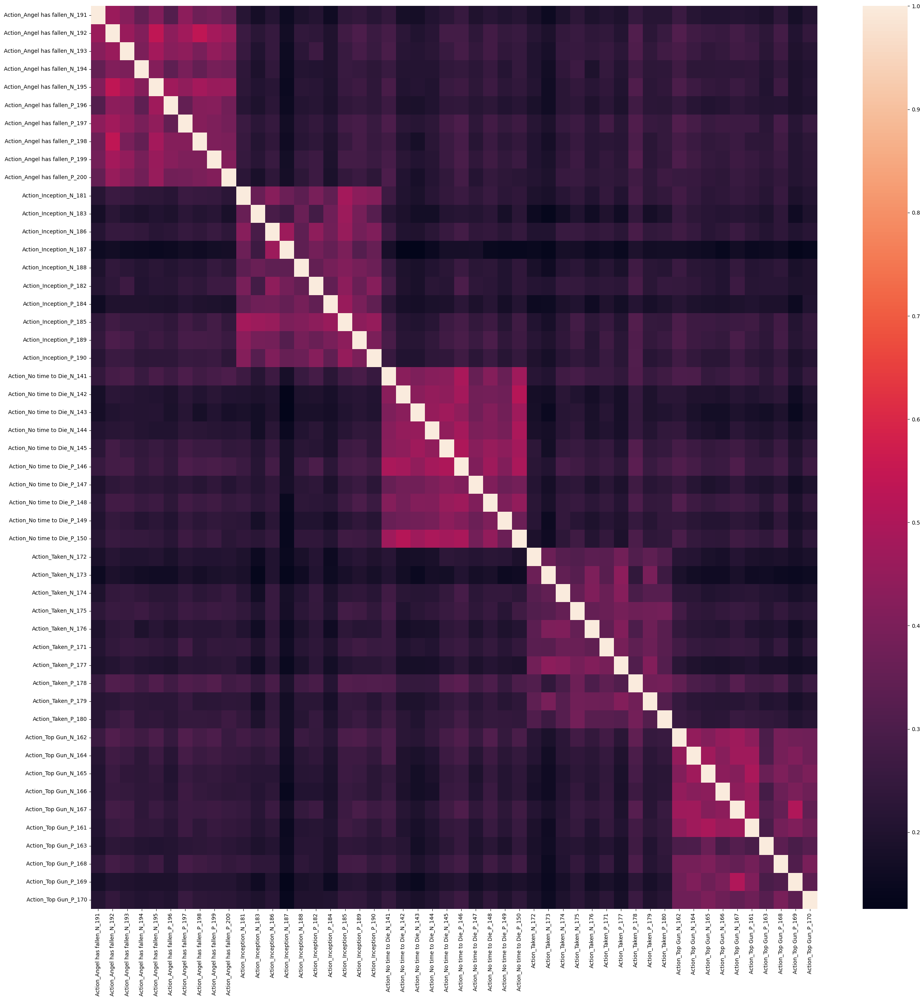

In [43]:
run_tfidf(documents, clean_method1, original_important_prevalent_terms, 'TFIDF_m1')

### 5.1.3 TF-IDF Using Clean2

,Mean TF-IDF
film,3.55
movie,3.33
one,2.41
like,2.09
ferrell,1.86
bond,1.84
batman,1.82
time,1.79
holmes,1.63
character,1.60


,All Movies
action,1.26
series,0.75
chase,0.48
wayne,0.31
knight,0.37
batman,1.82
character,1.60


Vocabulary size: 10703


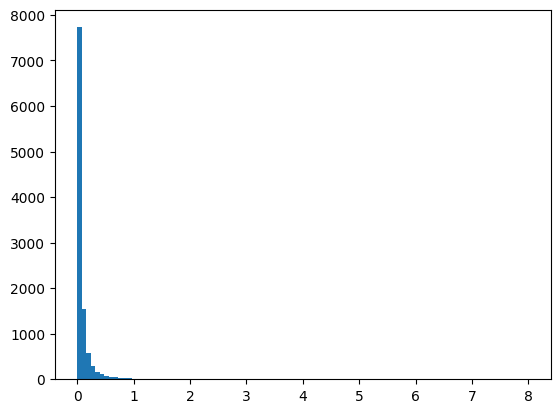

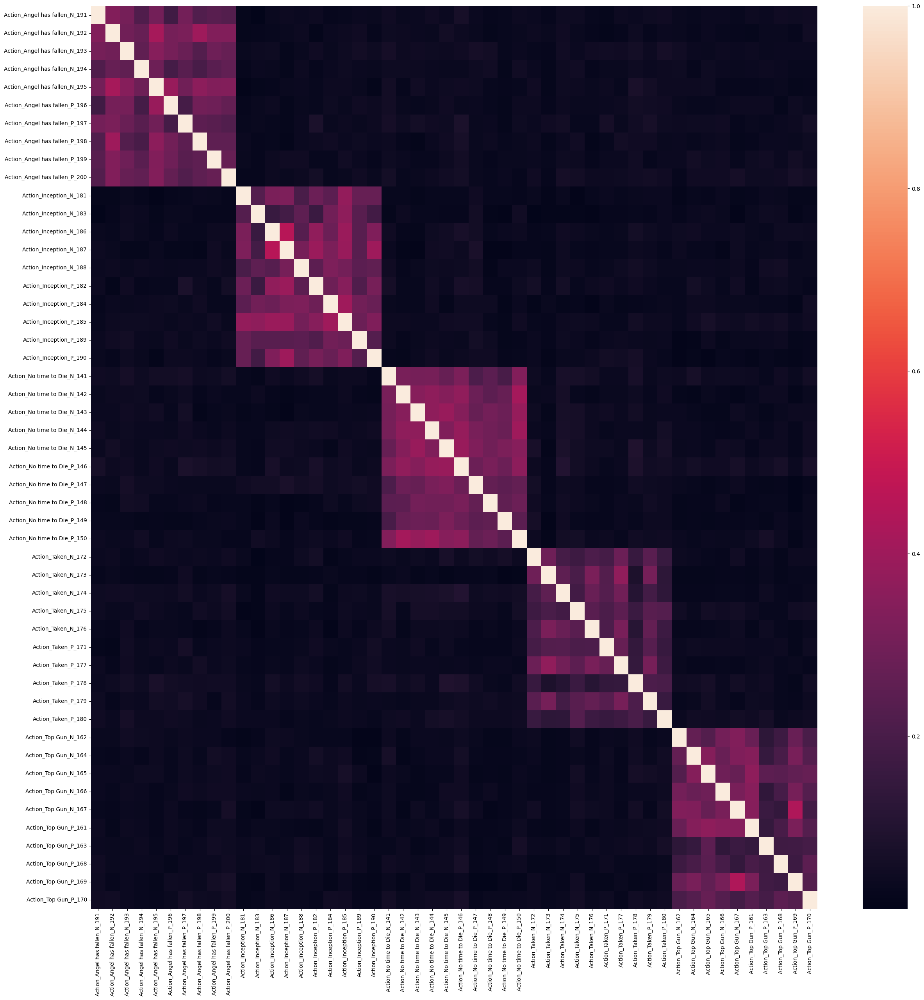

In [44]:
run_tfidf(documents, clean_method2, original_important_prevalent_terms, 'TFIDF_m2')

### 5.1.4 TF-IDF Using Clean3

,Mean TF-IDF
one,2.41
like,2.20
ferrel,1.87
time,1.83
batman,1.82
bond,1.81
holm,1.63
get,1.62
charact,1.60
make,1.48


,All Movies
action,1.28
seri,0.75
chase,0.49
wayn,0.31
knight,0.37
batman,1.82
charact,1.60


Vocabulary size: 8256


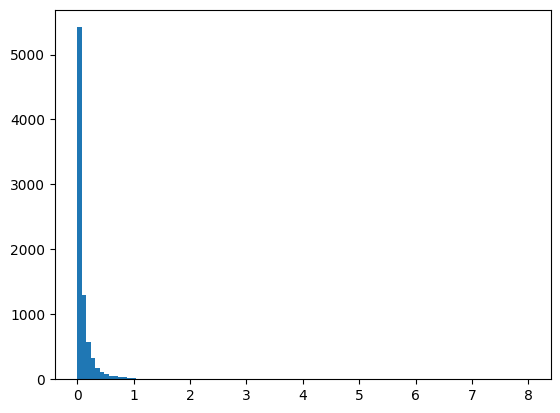

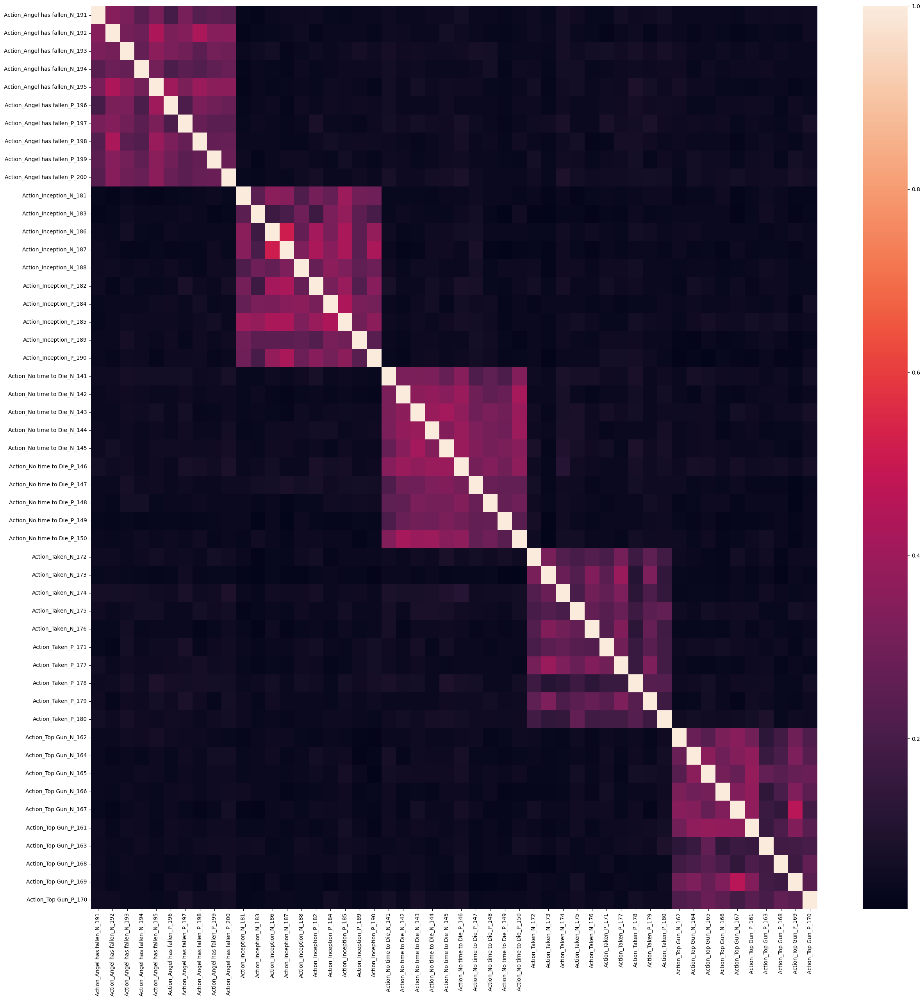

In [45]:
run_tfidf(documents, clean_method3, stemmed_important_prevalent_terms, 'TFIDF_m3')

# 6. Word2Vec experiments

## 6.0 Word2Vec Functions

In [46]:
def get_word2vec_vectors(documents: List[TokenizedDocument], embedding_size: int) -> pd.DataFrame:
    tokens = [x.tokens for x in documents]

    # https://github.com/RaRe-Technologies/gensim/wiki/Migrating-from-Gensim-3.x-to-4

    # gensim 3.8
    #word2vec_model = Word2Vec(tokens, size=embedding_size, window=3, min_count=1, workers=12)

    # gensim 4.3.1
    word2vec_model = Word2Vec(sentences=tokens, vector_size=embedding_size, window=3, min_count=1, workers=12)

    # gensim 3.8
    #vectors = {}
    #for i in word2vec_model.wv.vocab:
    #    temp_vec = word2vec_model.wv[i]
    #    vectors[i] = temp_vec

    # gensim 4.3.1
    vectors = {}
    for i in word2vec_model.wv.index_to_key:
        temp_vec = word2vec_model.wv[i]
        vectors[i] = temp_vec

    # Changes made:
    #   1. The size parameter in Word2Vec has been renamed to vector_size.
    #   2. Instead of iterating through word2vec_model.wv.vocab, you should now use 
    #      word2vec_model.wv.index_to_key to get the list of words in the vocabulary.


    result = pd.DataFrame(vectors).transpose()
    result = result.sort_index()
    return result
   
def plot_similarity_matrix(data: pd.DataFrame, experiment_name: str, figsize=(25, 25)):
    similarities = cosine_similarity(data, data)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(ax=ax, data=similarities, xticklabels=data.index, yticklabels=data.index);
    plt.savefig(f'figures/{experiment_name}_heatmap.png')
    plt.close()
    
def plot_similarity_clustermap(data: pd.DataFrame, experiment_name: str, figsize=(25, 25)):
    similarities = cosine_similarity(data, data)
    cm = sns.clustermap(similarities, metric='cosine', xticklabels=data.index, yticklabels=data.index, method='complete', cmap='RdBu', figsize=figsize)
    cm.ax_row_dendrogram.set_visible(False)
    cm.ax_col_dendrogram.set_visible(False)
    plt.legend(loc='upper left')
    plt.savefig(f'figures/{experiment_name}_clustermap.png')
    plt.show()
    plt.close()

def plot_tsne(data: pd.DataFrame, perplexity: int, experiment_name: str, figsize=(40, 40)):
    """
    Creates a TSNE plot of the supplied dataframe
    """
    tsne_model = TSNE(perplexity=perplexity, n_components=2, learning_rate='auto', init='pca', n_iter=1000, random_state=32)
    new_values = tsne_model.fit_transform(data)
    
    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=figsize)
    labels = list(data.index)
    for i in range(len(x)):
        new_value = new_values[i]
        x = new_value[0]
        y = new_value[1]
        
        plt.scatter(x, y)
        plt.annotate(labels[i],
                     xy=(x, y),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.savefig(f'figures/{experiment_name}_tsne.png')
    plt.show()
    plt.close()
    
def run_word2vec_experiment(documents: List[Document],
                            clean_func: Callable[[List[Document]], List[TokenizedDocument]],
                            embedding_size: int,
                            chosen_tokens: List[str],
                            experiment_name: str):
    cleaned_documents = clean_func(documents)

    word2vec_df = get_word2vec_vectors(cleaned_documents, embedding_size)
    filtered_word2vec_df = word2vec_df.loc[chosen_tokens].copy()

    plot_tsne(filtered_word2vec_df, 30, experiment_name)
    plot_similarity_matrix(filtered_word2vec_df, experiment_name)
    plot_similarity_clustermap(filtered_word2vec_df, experiment_name)

In [47]:
extra_terms = [
    'batman',
    'wayne',
    'knight',
    'action'
]

stemmer = PorterStemmer()
original_extra_terms = extra_terms.copy()
stemmed_extra_terms = [stemmer.stem(x) for x in extra_terms]

extra_terms

['batman', 'wayne', 'knight', 'action']

In [48]:
'''

This code was provided by the TA as a way to extract a set of random terms
I tackled this slightly differently but am including as a reference

# Get our terms to examine in experiements 4-12
all_tokens = get_all_tokens(remove_stop_words(clean_method(documents)))
chosen_tokens = random.choices(all_tokens, k=100 - len(extra_terms)) + extra_terms

lemmatizer = WordNetLemmatizer()
lemmatized_chosen_tokens = [lemmatizer.lemmatize(x) for x in chosen_tokens]
stemmed_chosen_tokens = [stemmer.stem(x) for x in lemmatized_chosen_tokens]

'''

'\n\nThis code was provided by the TA as a way to extract a set of random terms\nI tackled this slightly differently but am including as a reference\n\n# Get our terms to examine in experiements 4-12\nall_tokens = get_all_tokens(remove_stop_words(clean_method(documents)))\nchosen_tokens = random.choices(all_tokens, k=100 - len(extra_terms)) + extra_terms\n\nlemmatizer = WordNetLemmatizer()\nlemmatized_chosen_tokens = [lemmatizer.lemmatize(x) for x in chosen_tokens]\nstemmed_chosen_tokens = [stemmer.stem(x) for x in lemmatized_chosen_tokens]\n\n'

In [49]:
#standard1

#chosen_tokens1 = random.choices(all_tokens1, k = 100 - len(original_extra_terms)) + original_extra_terms

#chosen_tokens1 = random.choices(all_tokens1, k = 100 - len(original_extra_terms))

#type(chosen_tokens1)

In [50]:
np.random.seed(random_seed)

all_tokens1 = get_all_tokens(standard1)
all_tokens2 = get_all_tokens(standard2)
all_tokens3 = get_all_tokens(standard3)

chosen_tokens_m1  =   np.random.choice(all_tokens1, size=(100 - len(original_extra_terms)), replace=False).tolist() + original_extra_terms
chosen_tokens_m2  =   np.random.choice(all_tokens2, size=(100 - len(original_extra_terms)), replace=False).tolist() + original_extra_terms
chosen_tokens_m3  =   np.random.choice(all_tokens3, size=(100 - len(original_extra_terms)), replace=False).tolist() + stemmed_extra_terms


## 6.1 Word2Vec Cleaning Method 1

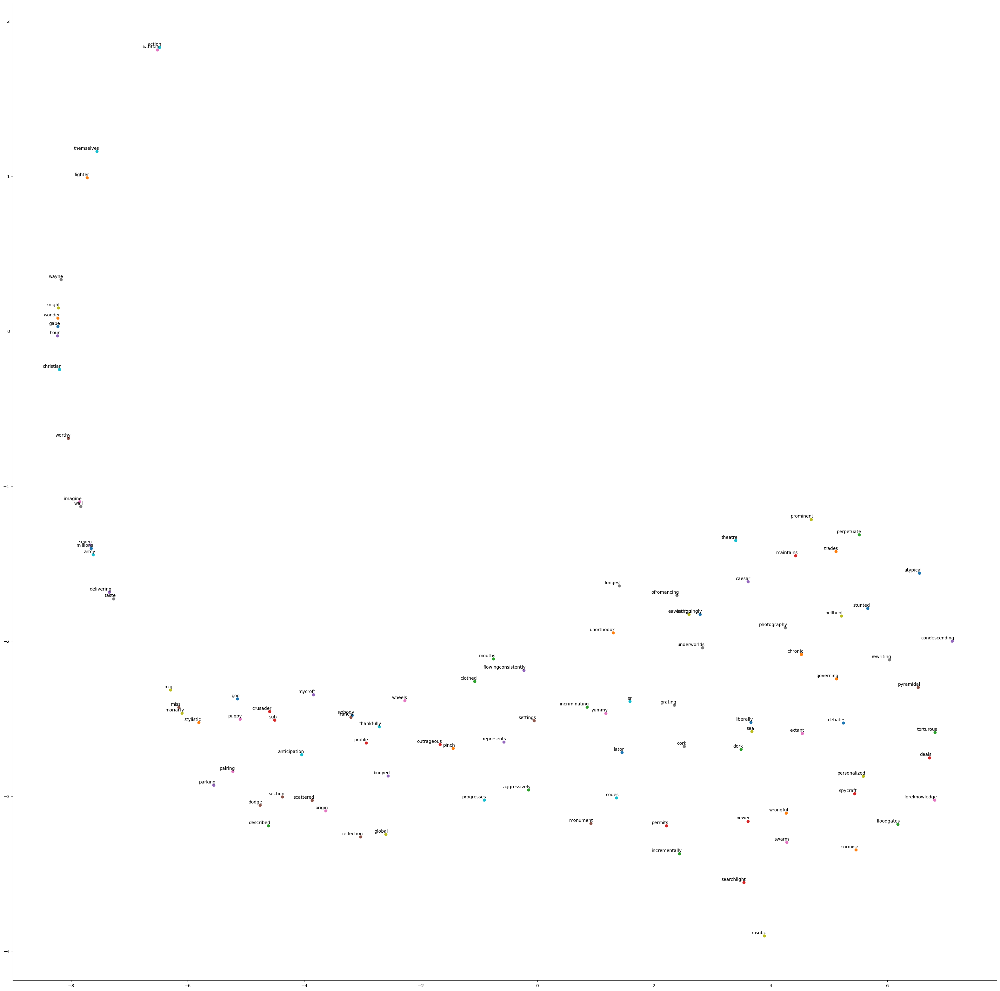

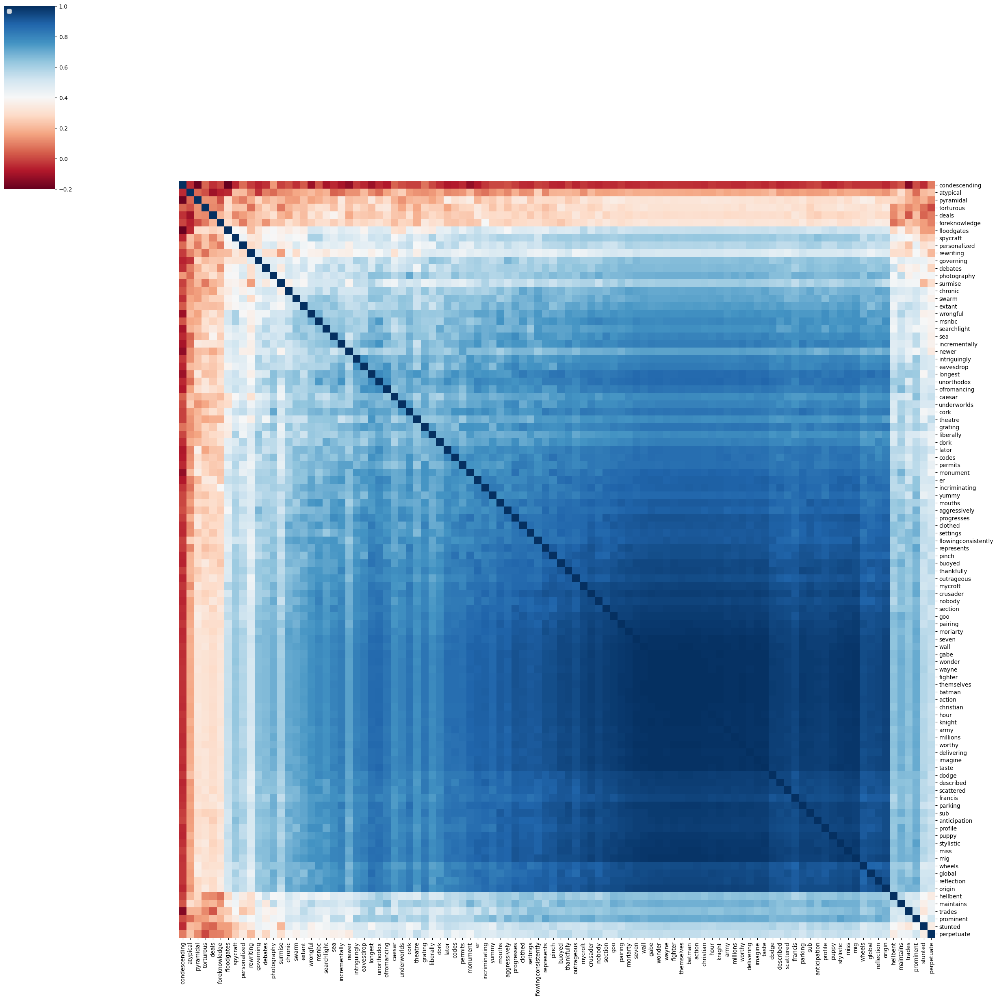

In [51]:
run_word2vec_experiment(documents, clean_method1, 100, chosen_tokens_m1, 'Word2Vec_m1_e100')

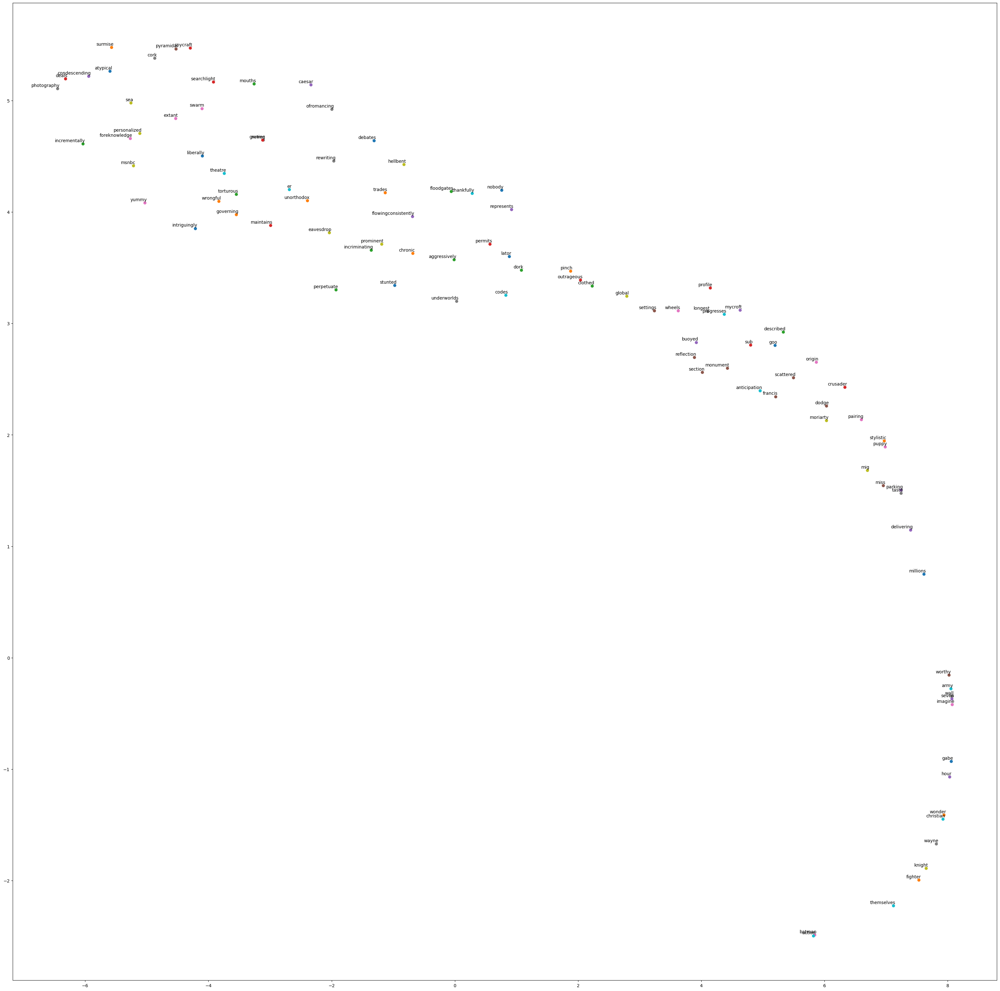

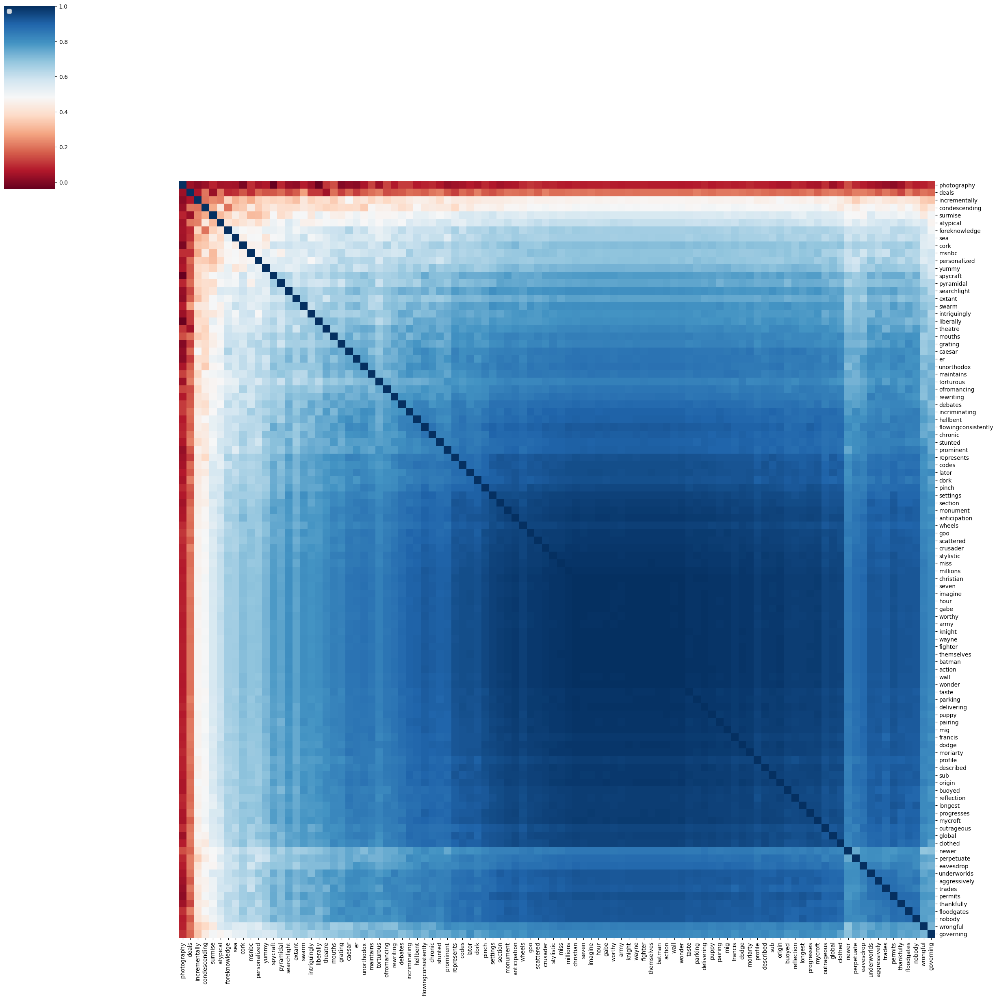

In [52]:
run_word2vec_experiment(documents, clean_method1, 200, chosen_tokens_m1, 'Word2Vec_m1_e200')

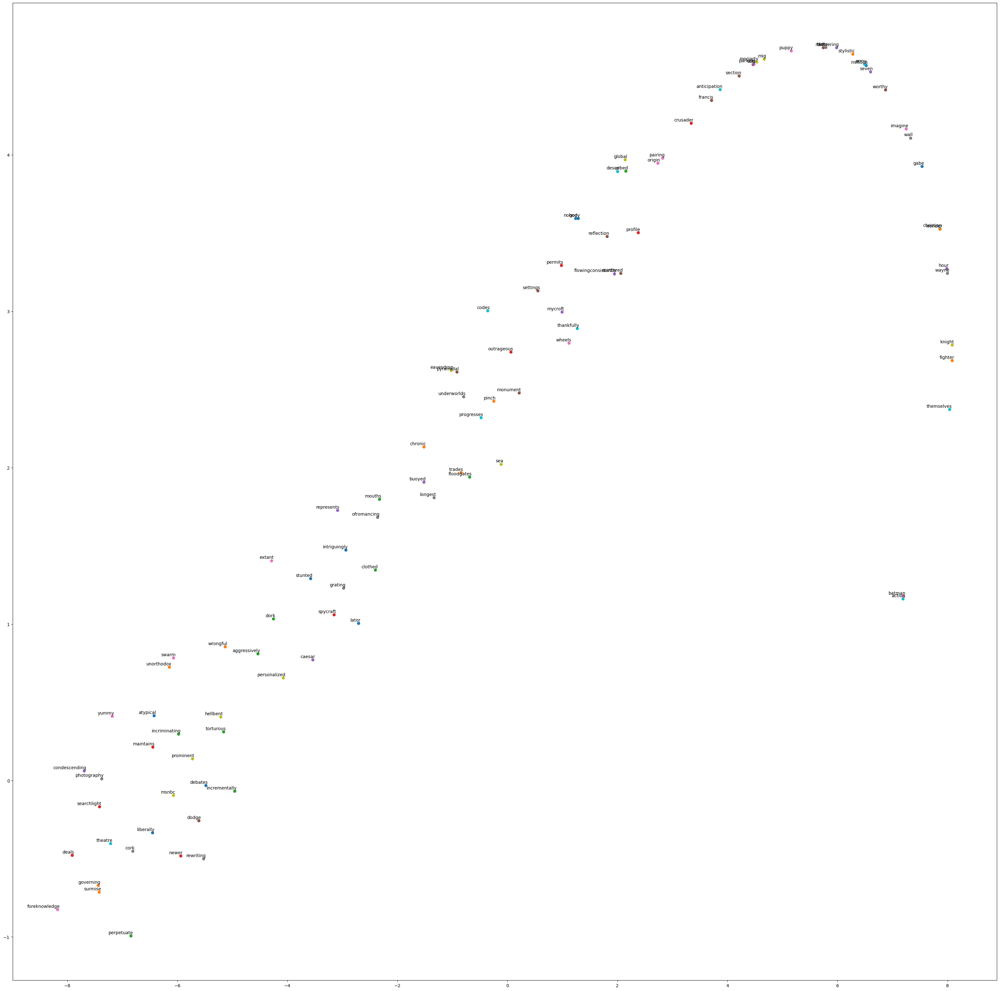

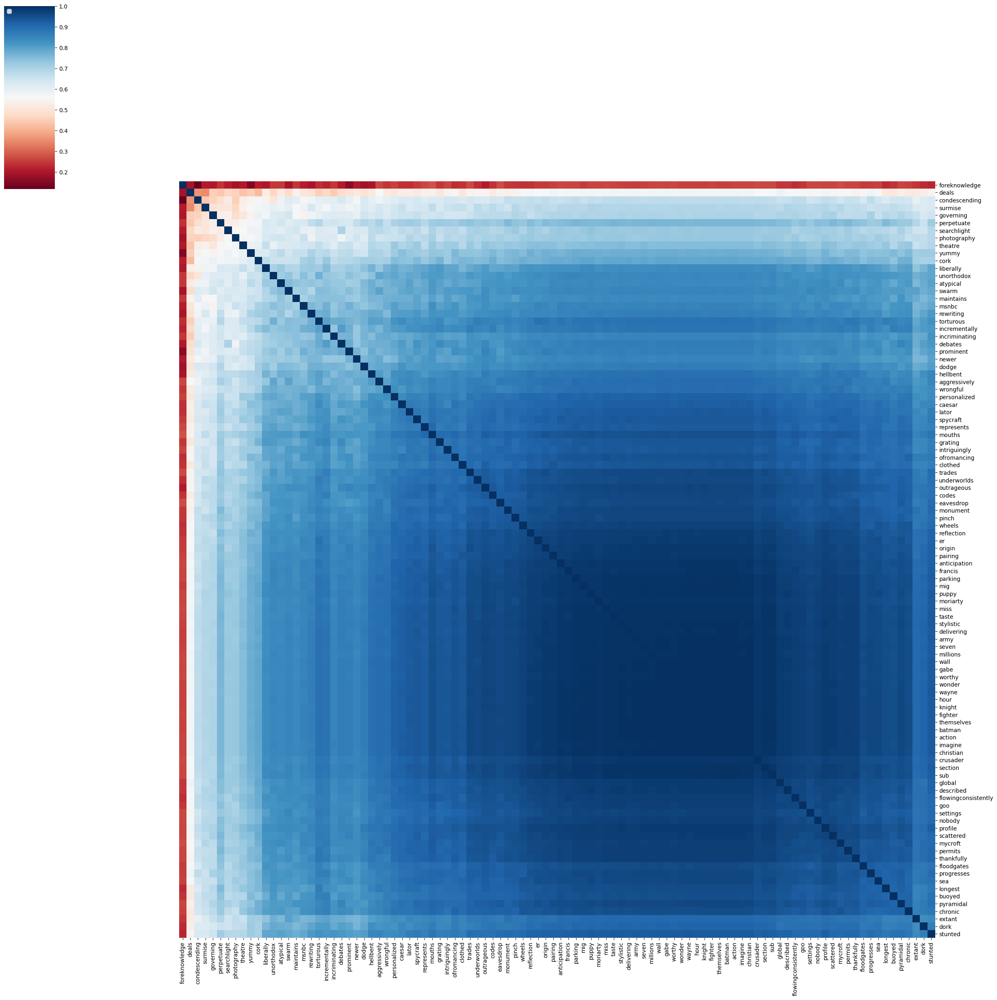

In [53]:
run_word2vec_experiment(documents, clean_method1, 300, chosen_tokens_m1, 'Word2Vec_m1_e300')

## 6.2 Word2Vec Cleaning Method 2

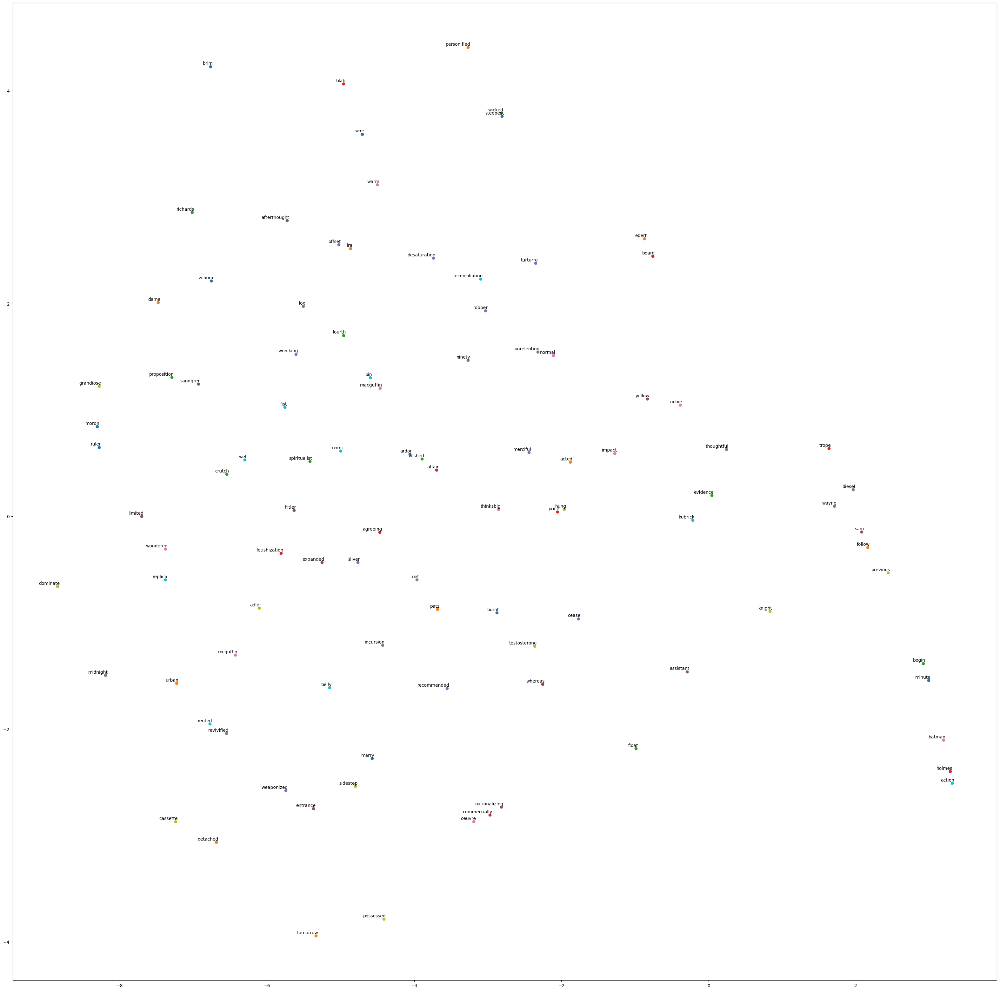

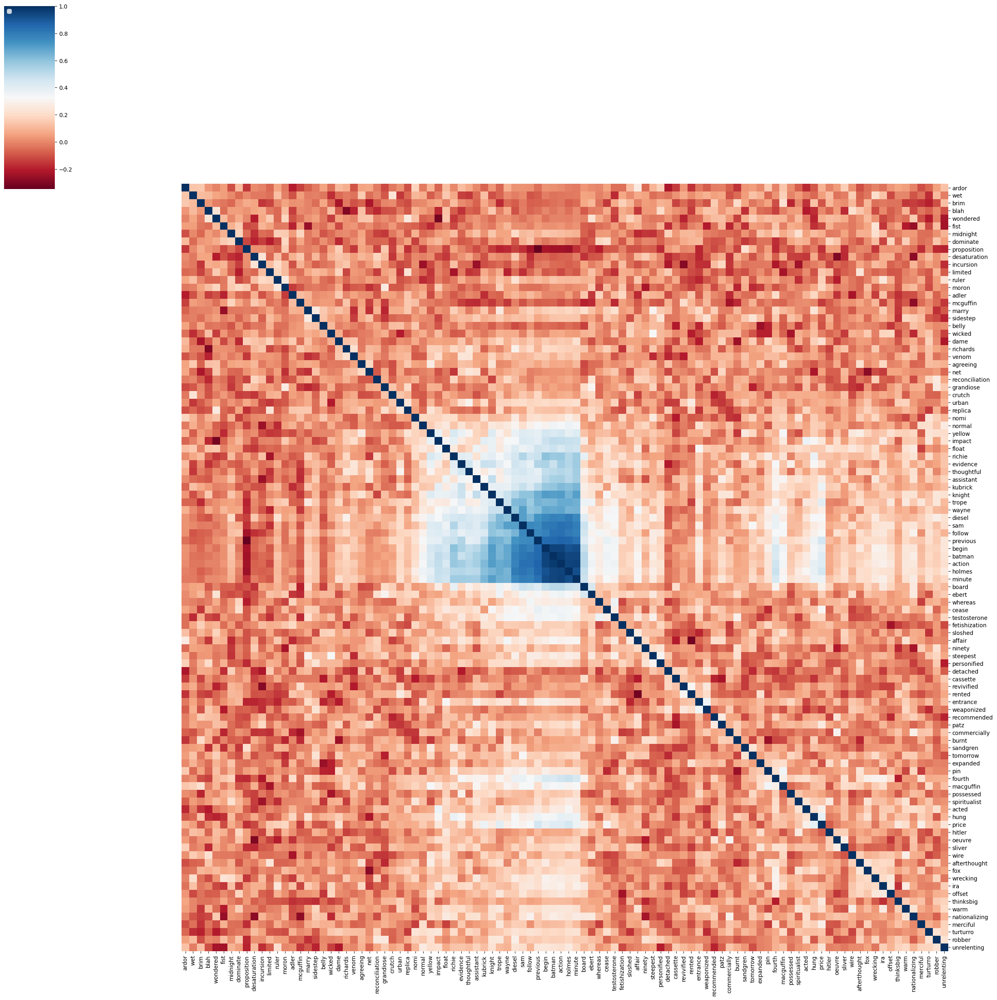

In [54]:
run_word2vec_experiment(documents, clean_method2, 100, chosen_tokens_m2, 'Word2Vec_m2_e100')

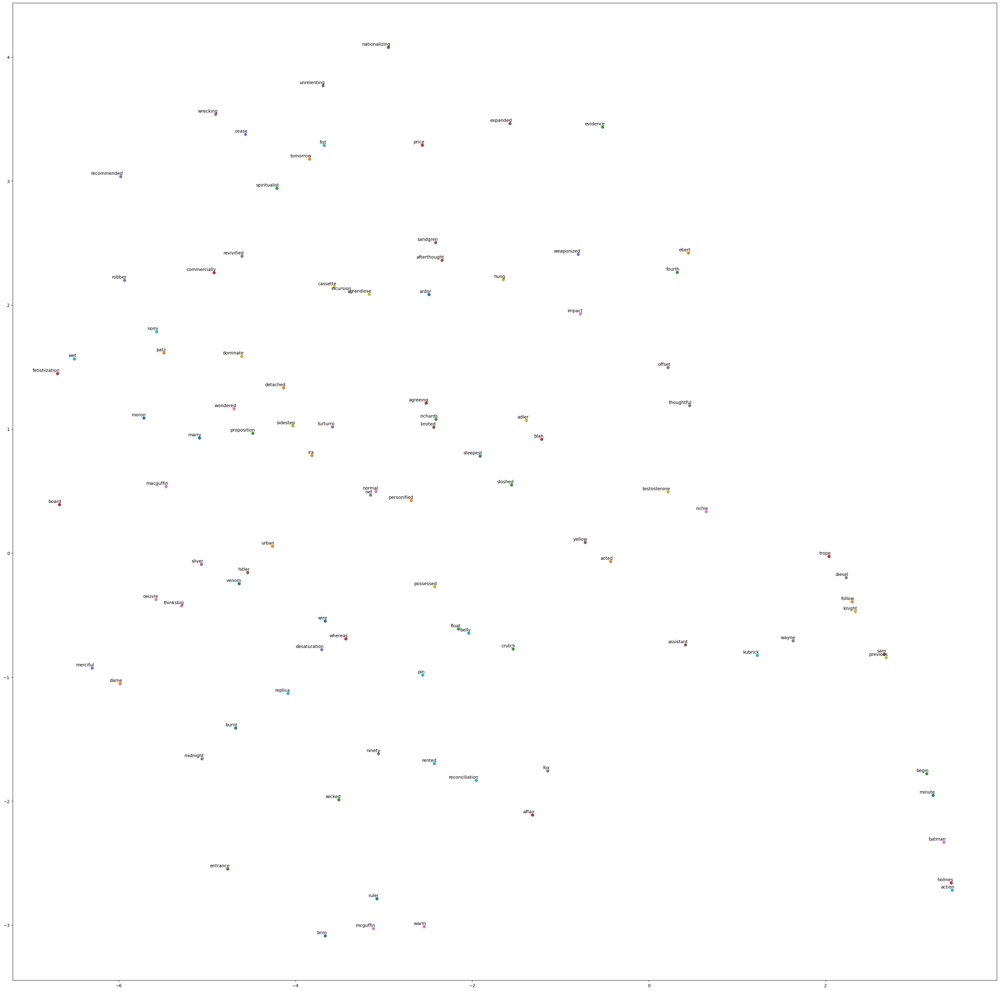

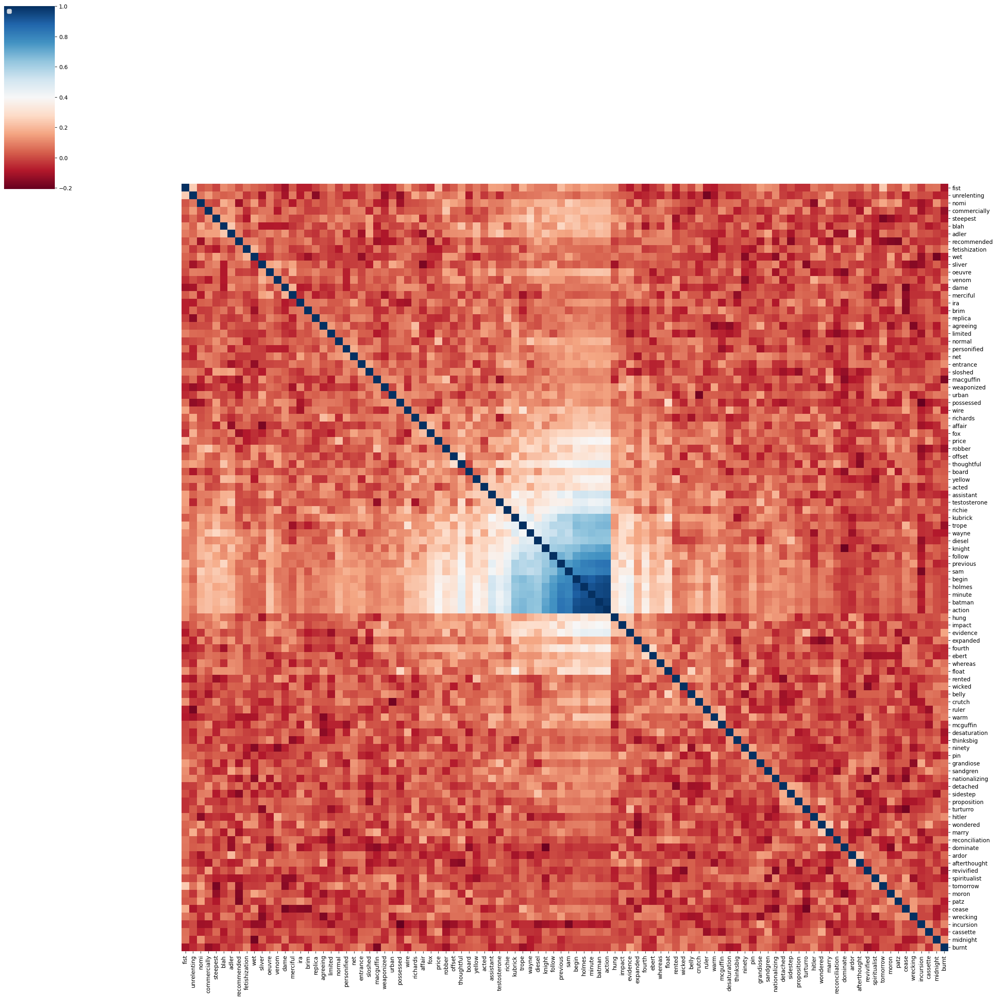

In [55]:
run_word2vec_experiment(documents, clean_method2, 200, chosen_tokens_m2, 'Word2Vec_m2_e200')

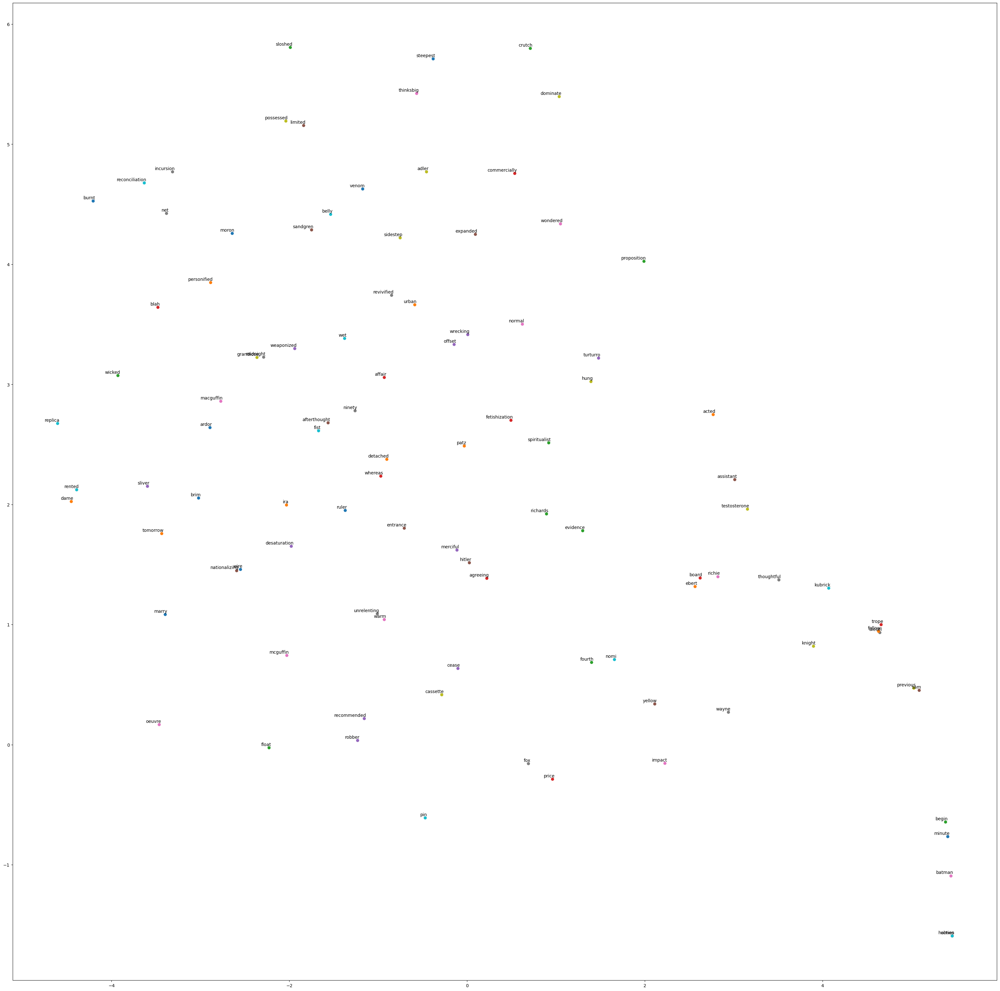

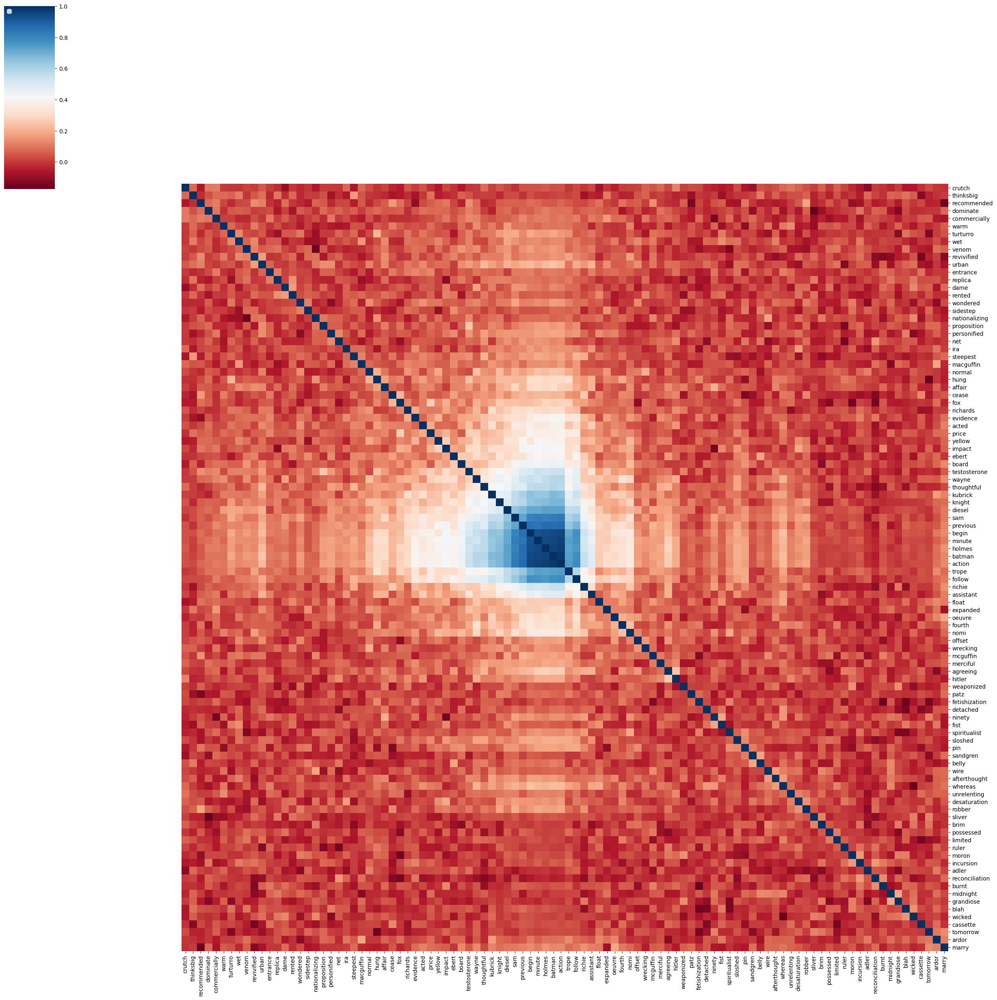

In [56]:
run_word2vec_experiment(documents, clean_method2, 300, chosen_tokens_m2, 'Word2Vec_m2_e300')

## 6.3 Word2Vec Cleaning Method 3

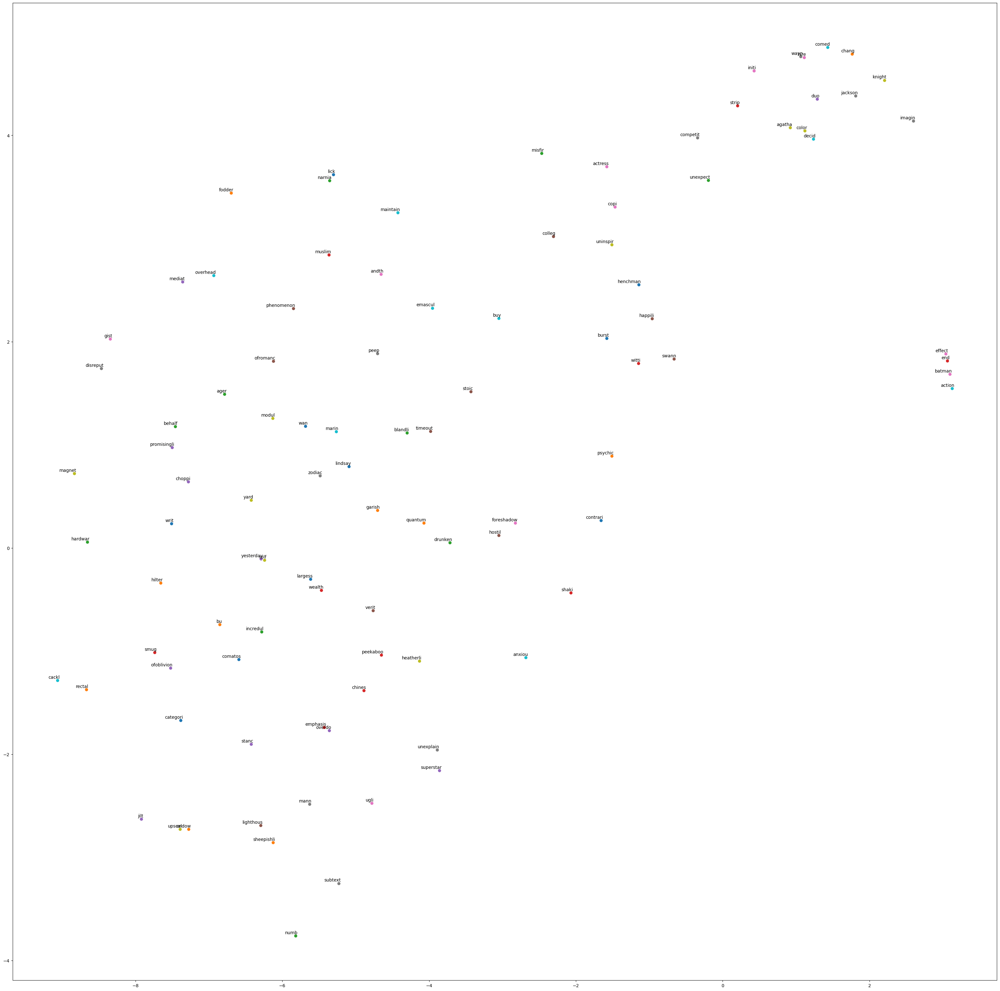

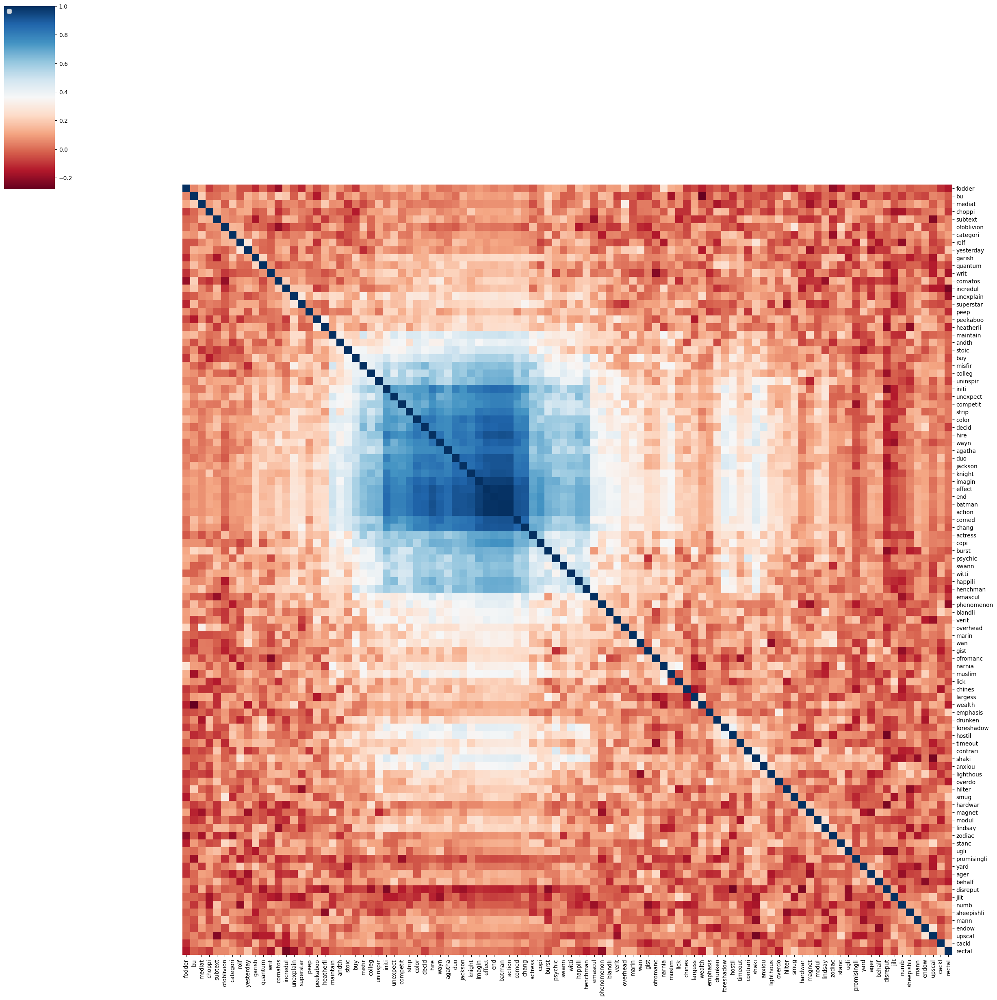

In [57]:
run_word2vec_experiment(documents, clean_method3, 100, chosen_tokens_m3, 'Word2Vec_m3_e100')

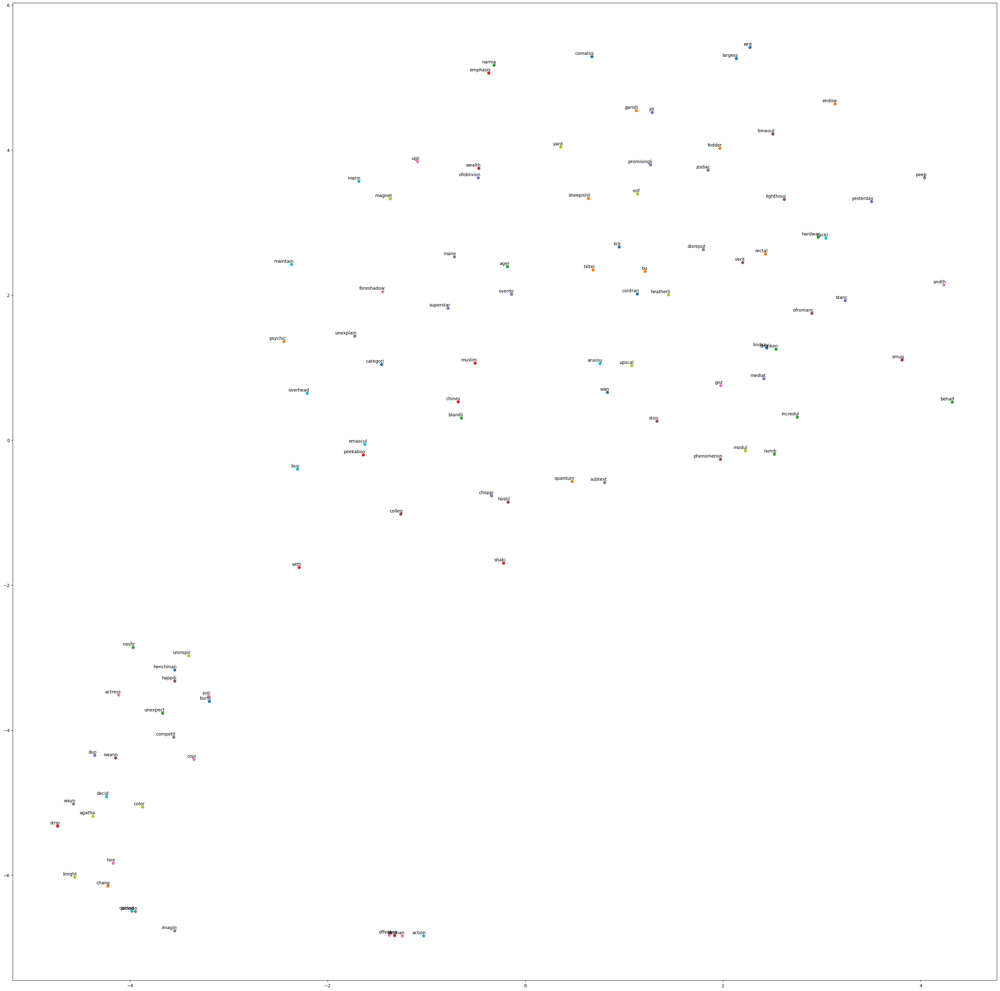

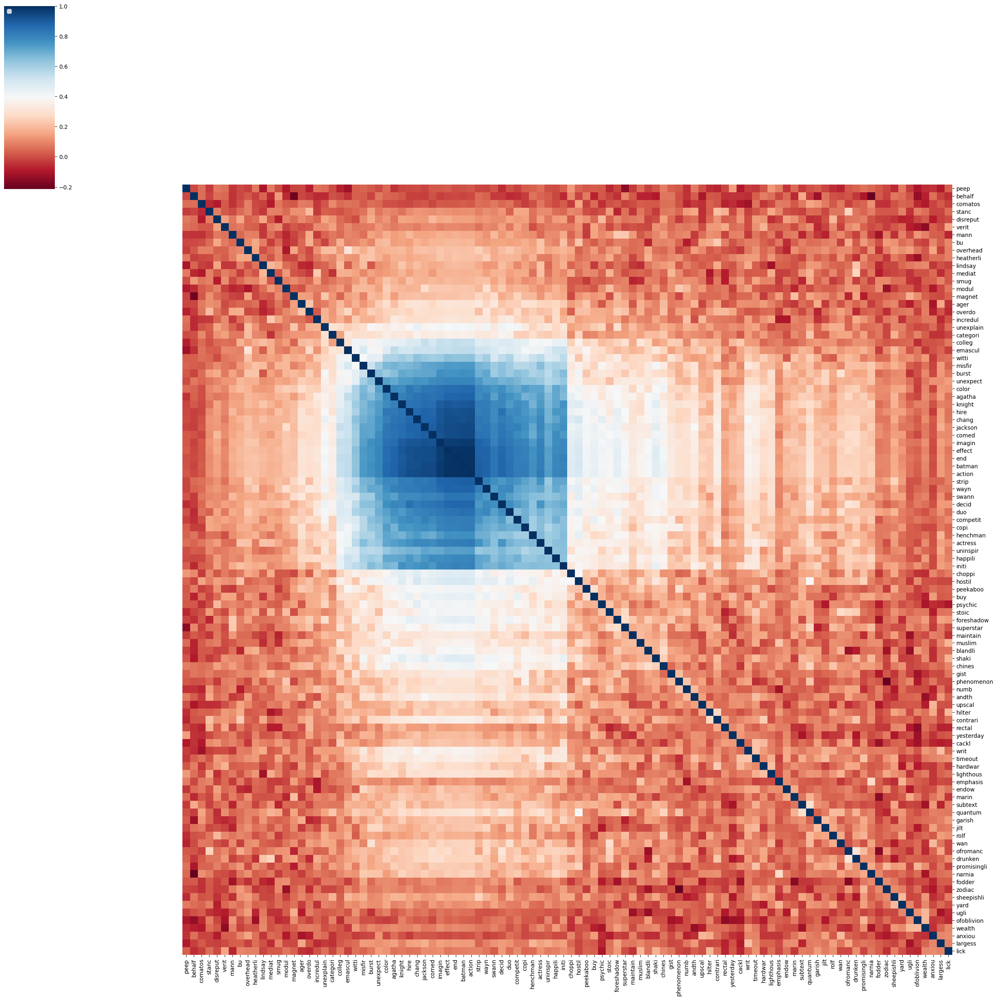

In [58]:
run_word2vec_experiment(documents, clean_method3, 200, chosen_tokens_m3, 'Word2Vec_m3_e200')

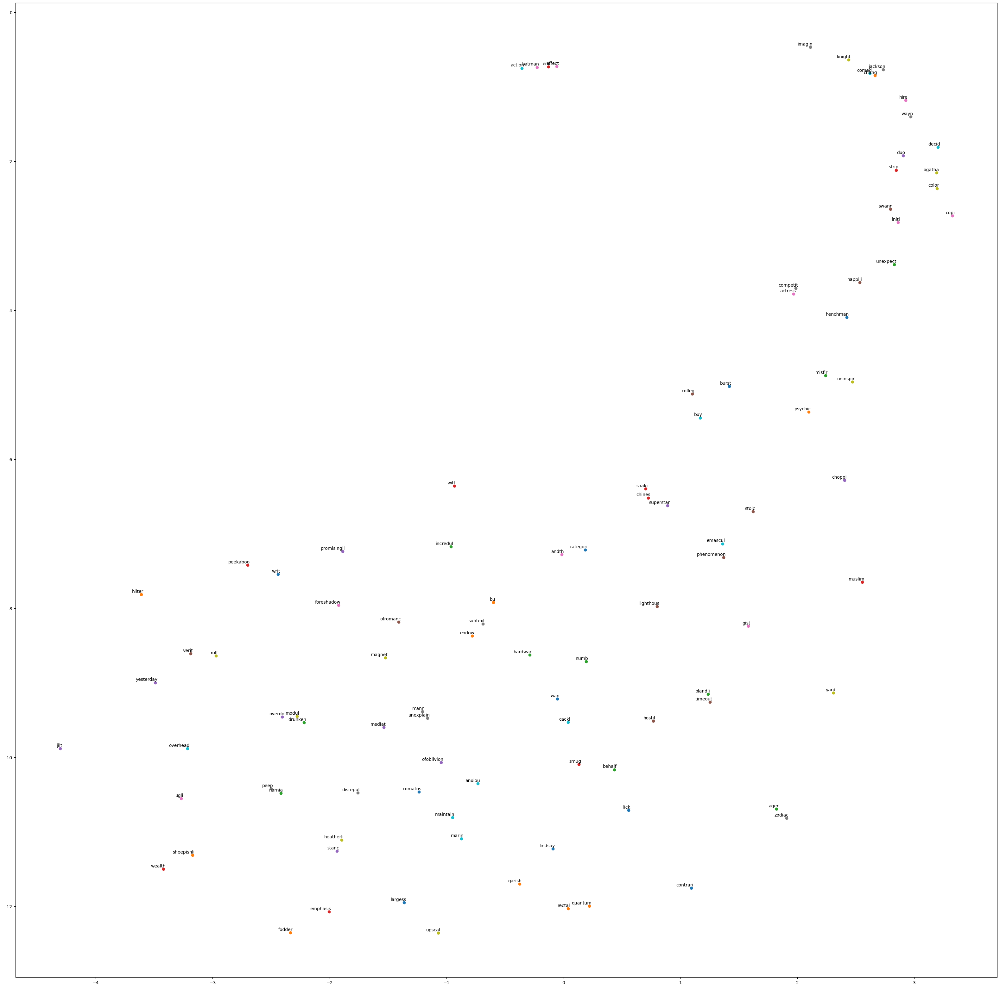

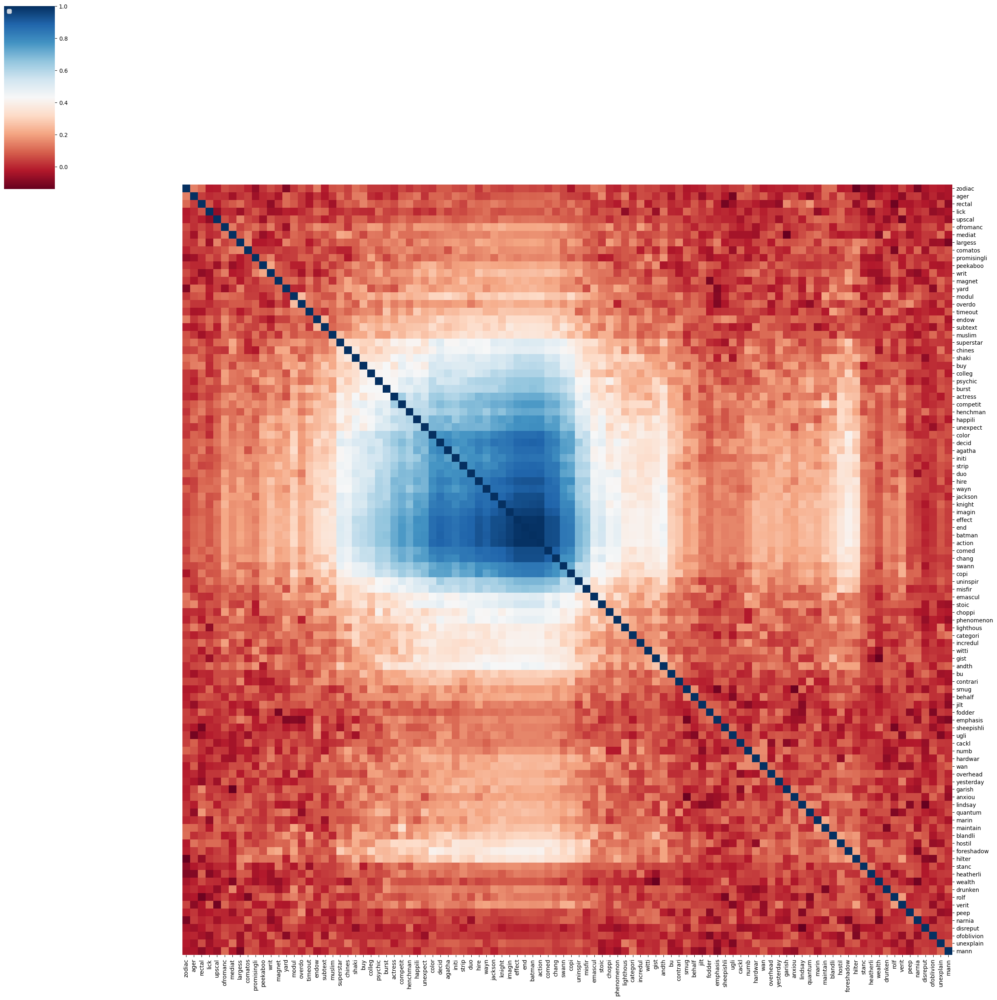

In [59]:
run_word2vec_experiment(documents, clean_method3, 300, chosen_tokens_m3, 'Word2Vec_m3_e300')

# 7. Doc2Vec Experiments

## 7.0 Utility Functions

In [60]:
def run_doc2vec(documents: List[TokenizedDocument], embedding_size: int, descriptors_by_doc_ids: Dict[int, str]):
    tagged_documents = [TaggedDocument(document.tokens, [i]) for i, document in enumerate(documents)]
    doc2vec_model = Doc2Vec(tagged_documents, vector_size=embedding_size, window=3, min_count=2, workers=12)    
    
    doc2vec_df = pd.DataFrame()
    for document in documents:
        vector = pd.DataFrame(doc2vec_model.infer_vector(document.tokens)).transpose()
        doc2vec_df = pd.concat([doc2vec_df, vector], axis=0)
    
    doc2vec_df['Descriptor'] = [descriptors_by_doc_ids[x.doc_id] for x in documents]
    doc2vec_df.set_index(['Descriptor'], inplace=True)
    return doc2vec_df

def run_doc2vec_experiment(documents: List[Document],
                           clean_func: Callable[[List[Document]], List[TokenizedDocument]],
                           embedding_size: int,
                           experiment_name: str):
    cleaned_documents = clean_func(documents)
    doc2vec_df = run_doc2vec(cleaned_documents, embedding_size, descriptors_by_doc_ids)
    
    plot_similarity_matrix(doc2vec_df, experiment_name)
    plot_similarity_clustermap(doc2vec_df, experiment_name, figsize=(50, 50))
    plot_tsne(doc2vec_df, 30, experiment_name)

## 7.1 Doc2Vec Cleaning Method 1

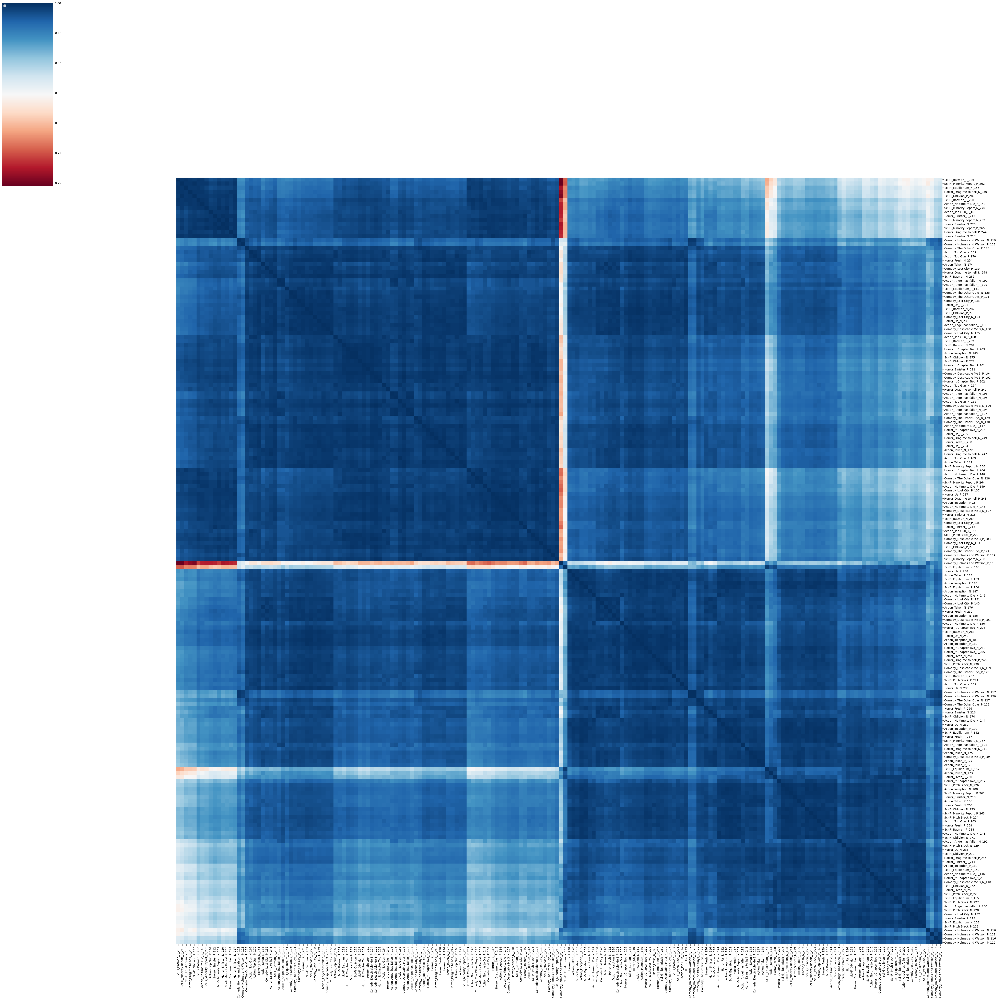

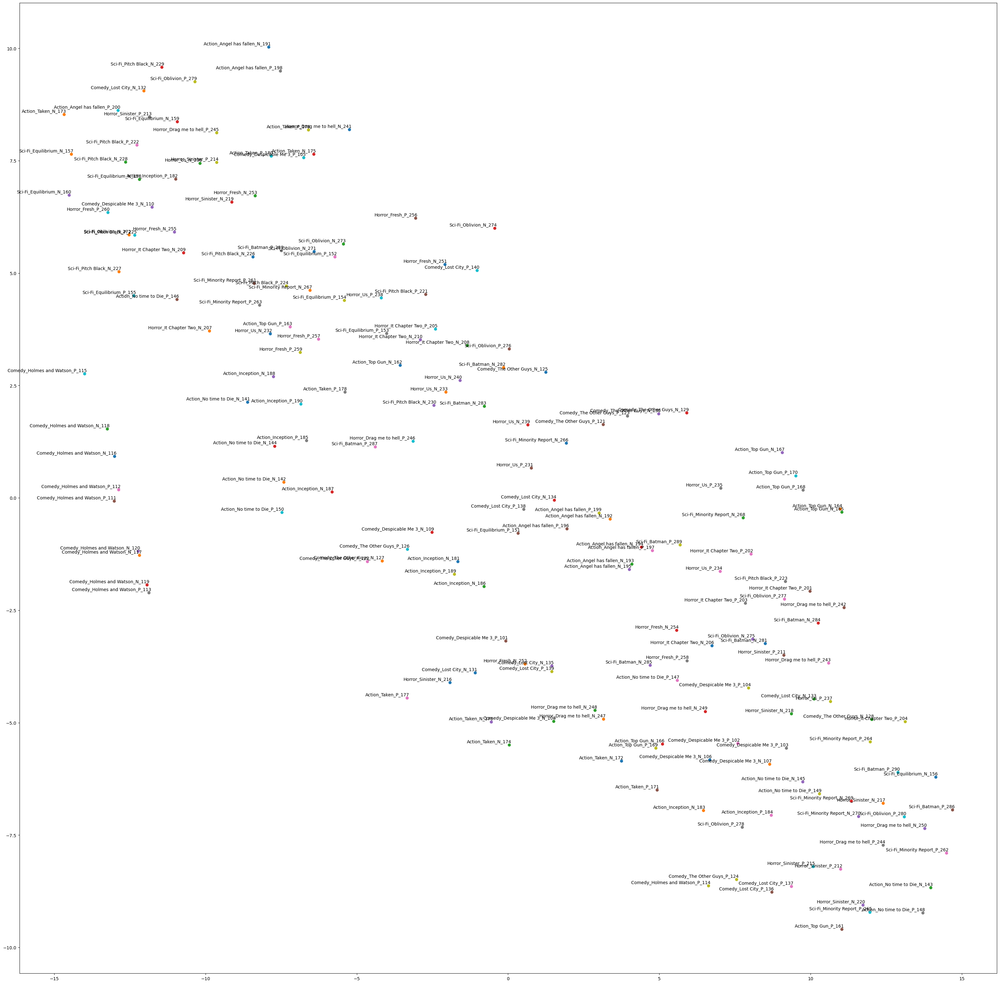

In [61]:
run_doc2vec_experiment(documents, clean_method1, 100, 'Doc2Vec_m1_e100')

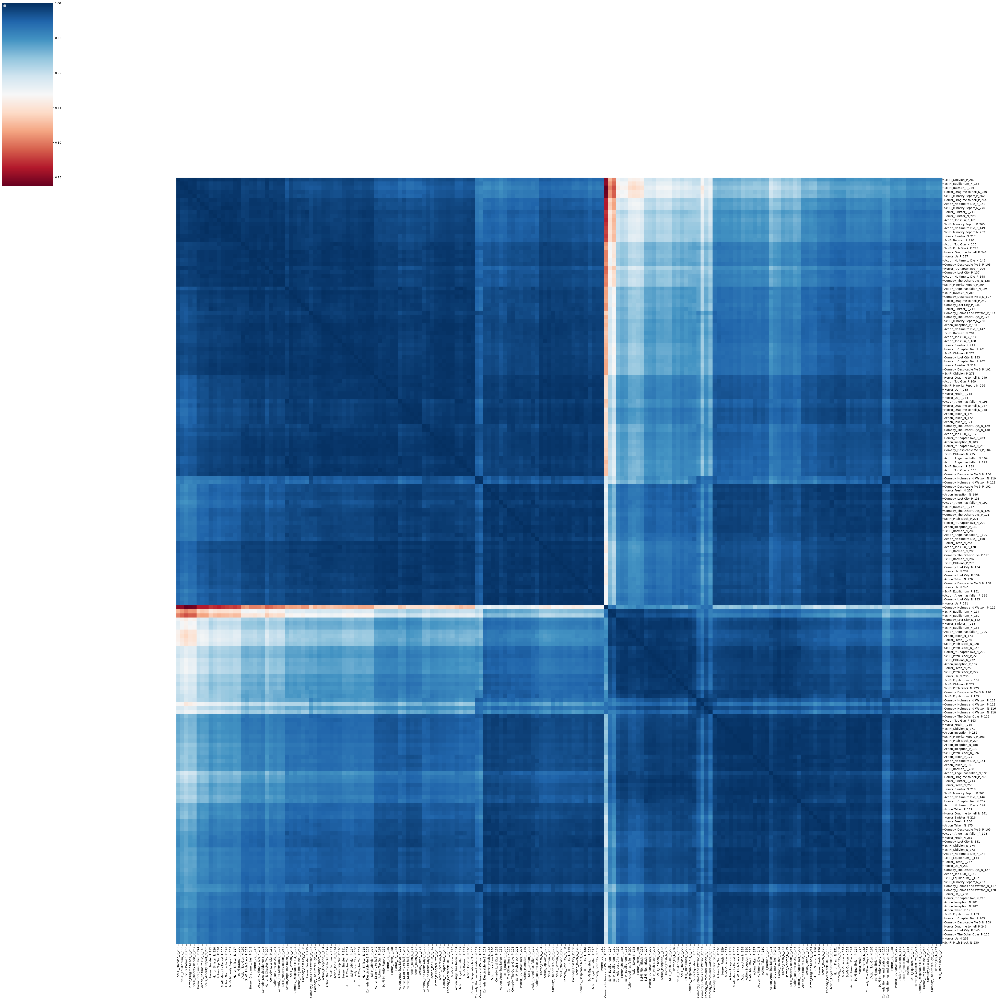

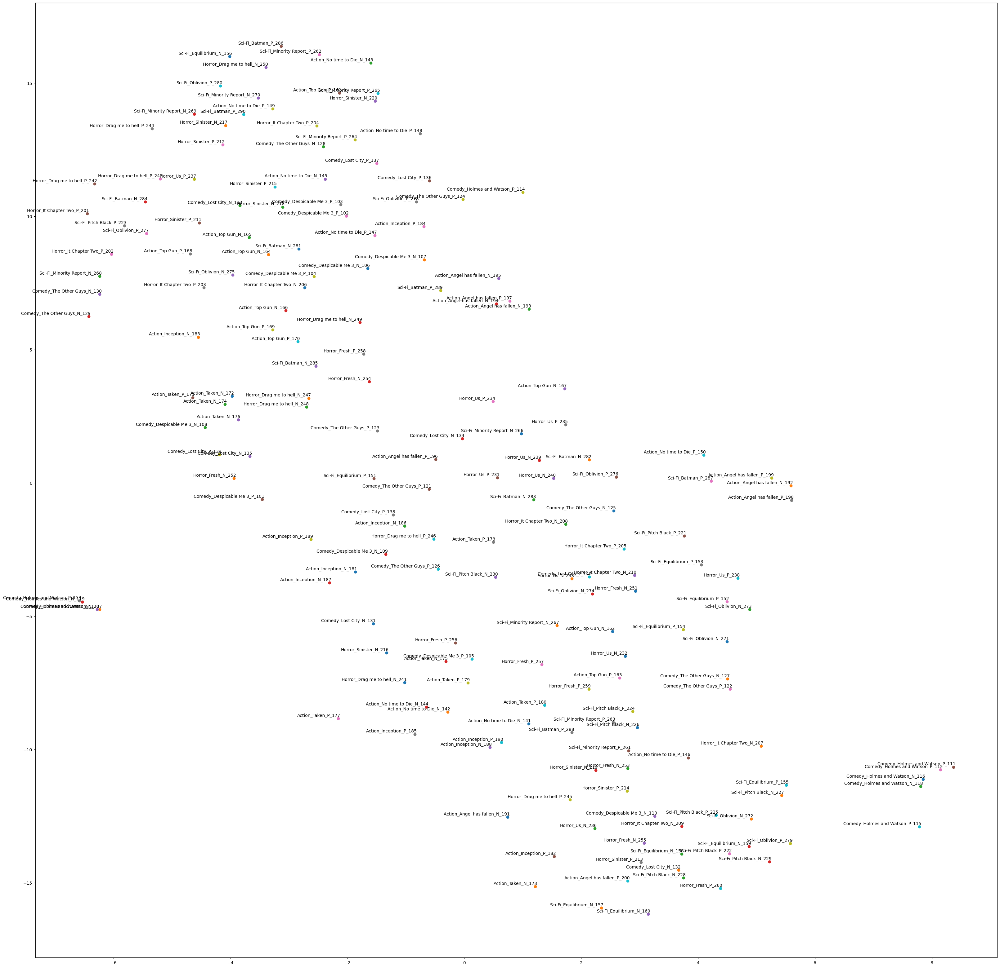

In [62]:
run_doc2vec_experiment(documents, clean_method1, 200, 'Doc2Vec_m1_e200')

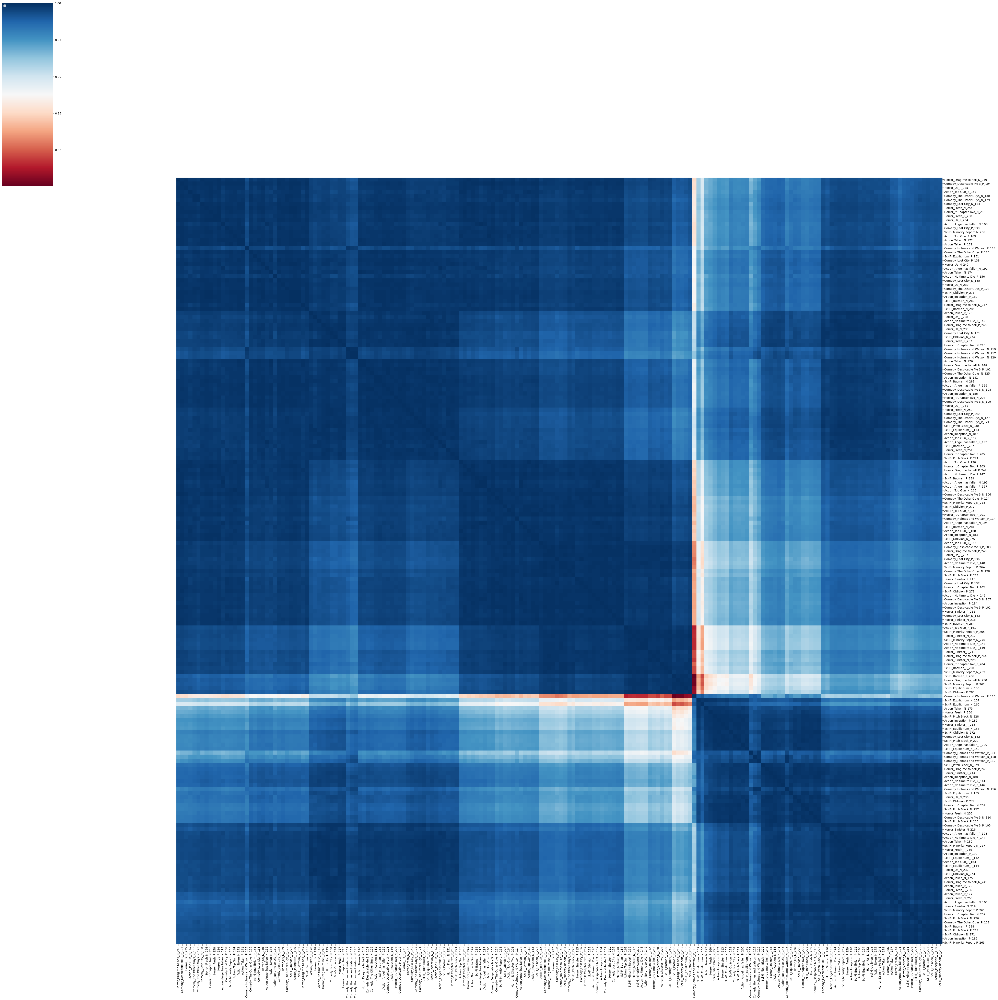

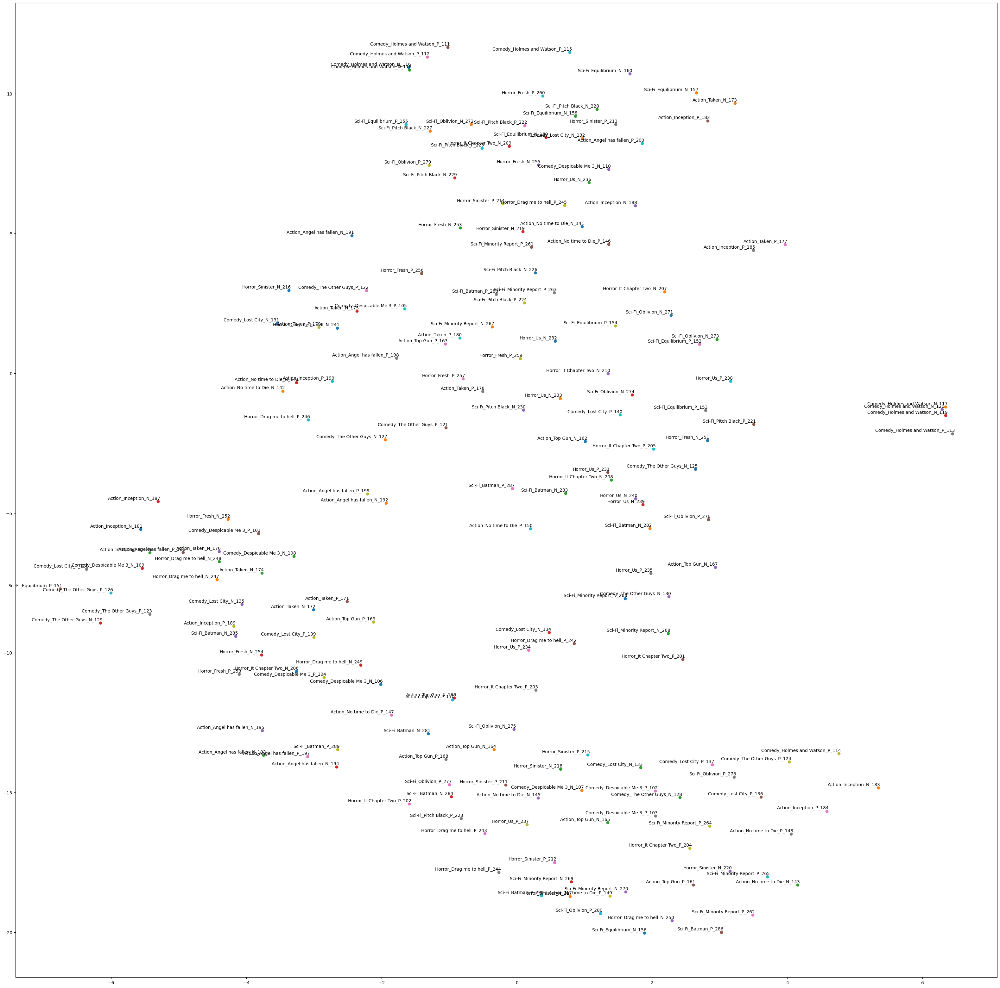

In [63]:
run_doc2vec_experiment(documents, clean_method1, 300, 'Doc2Vec_m1_e300')

## 7.2 Doc2Vec Cleaning Method 2

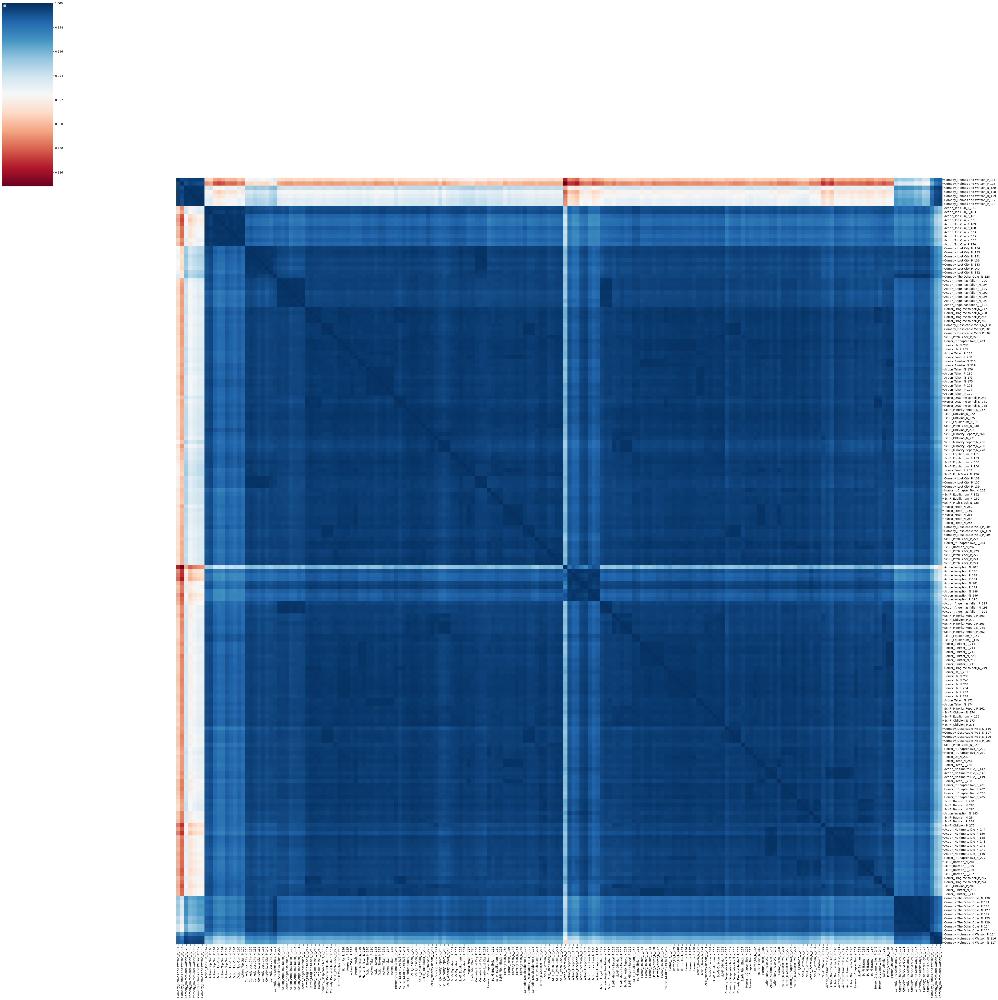

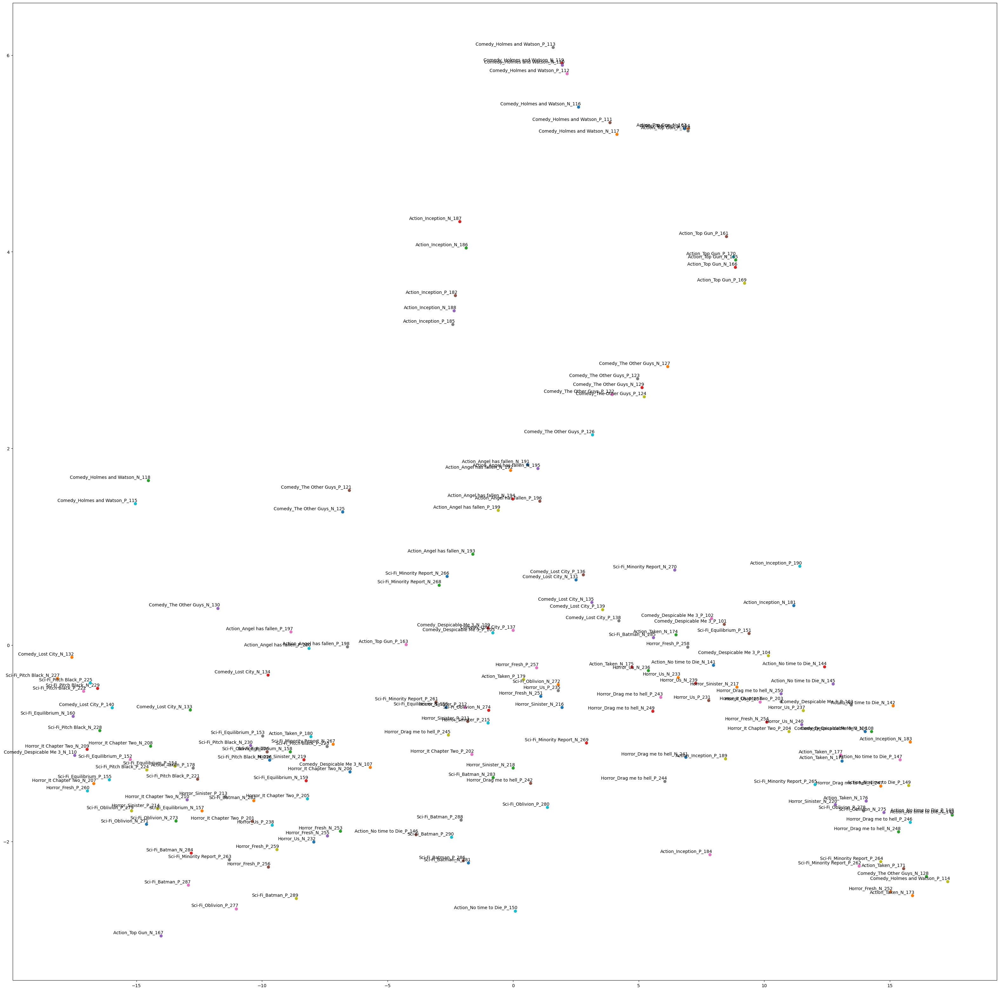

In [64]:
run_doc2vec_experiment(documents, clean_method2, 100, 'Doc2Vec_m2_e100')

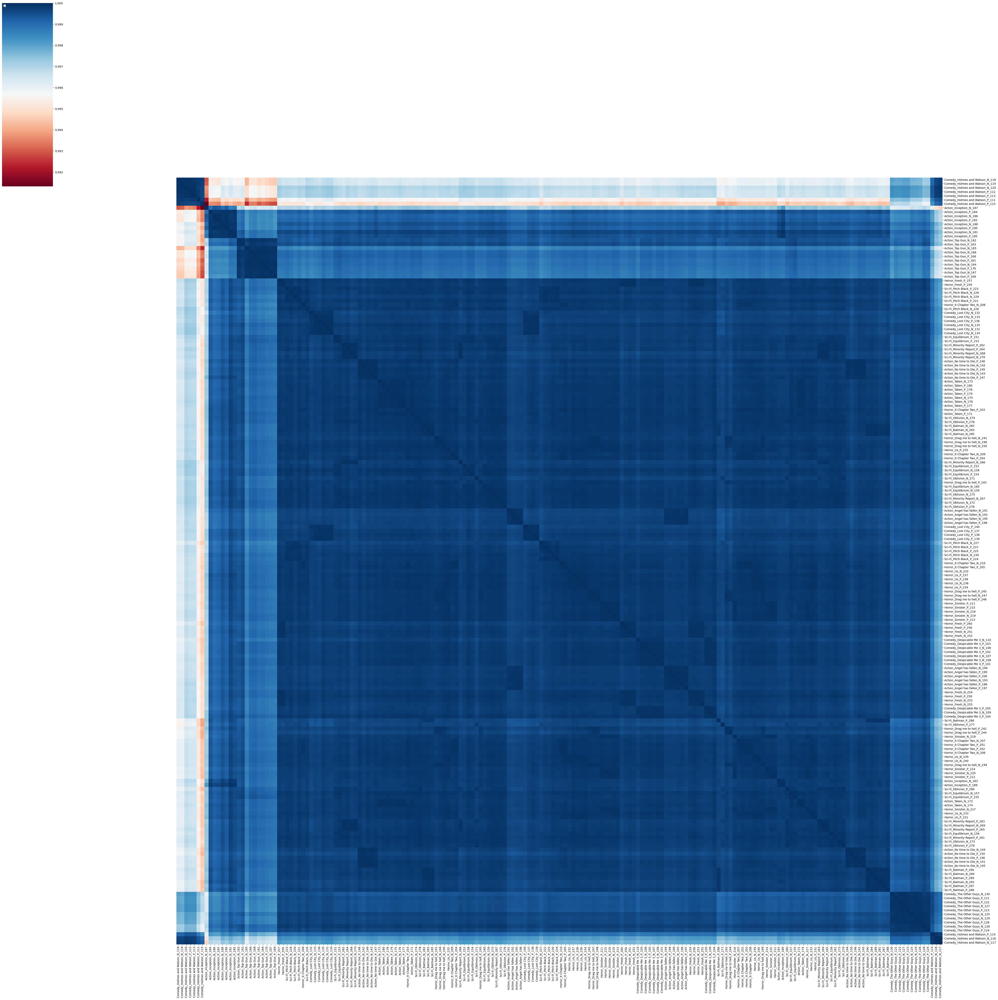

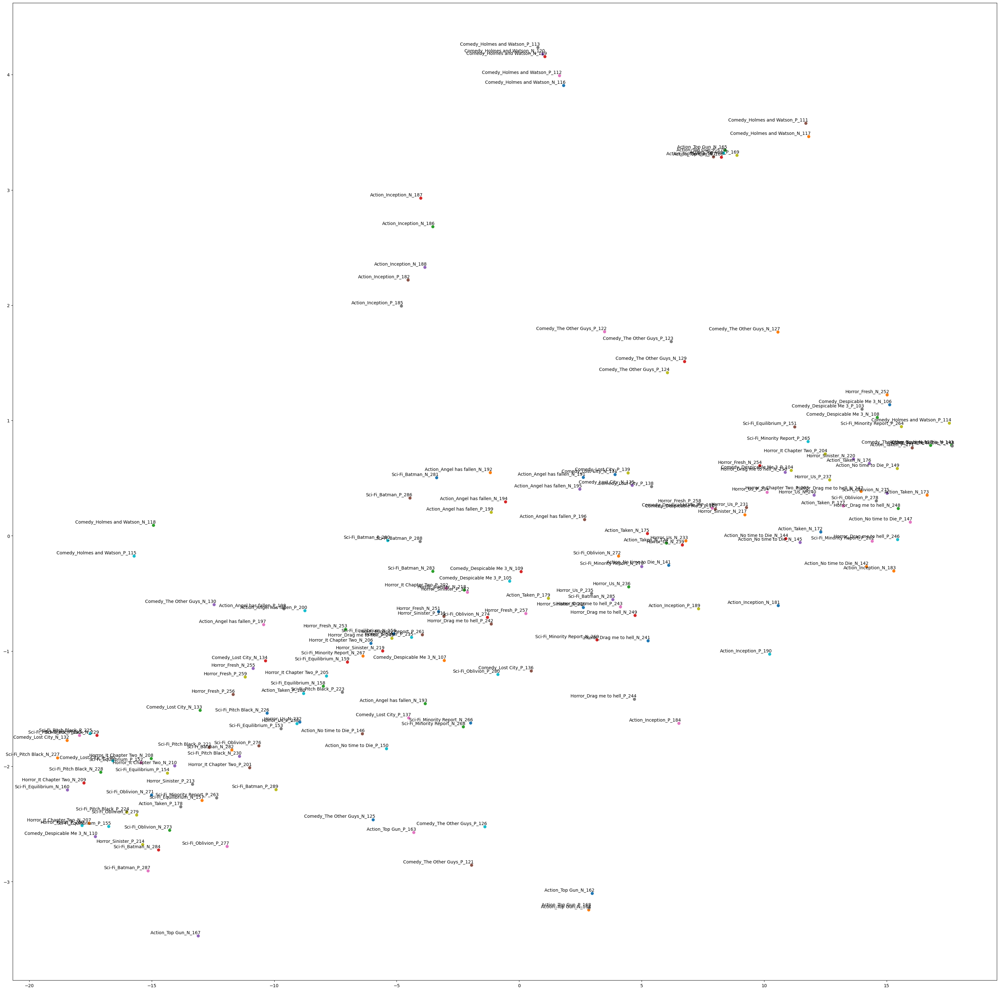

In [65]:
run_doc2vec_experiment(documents, clean_method2, 200, 'Doc2Vec_m2_e200')

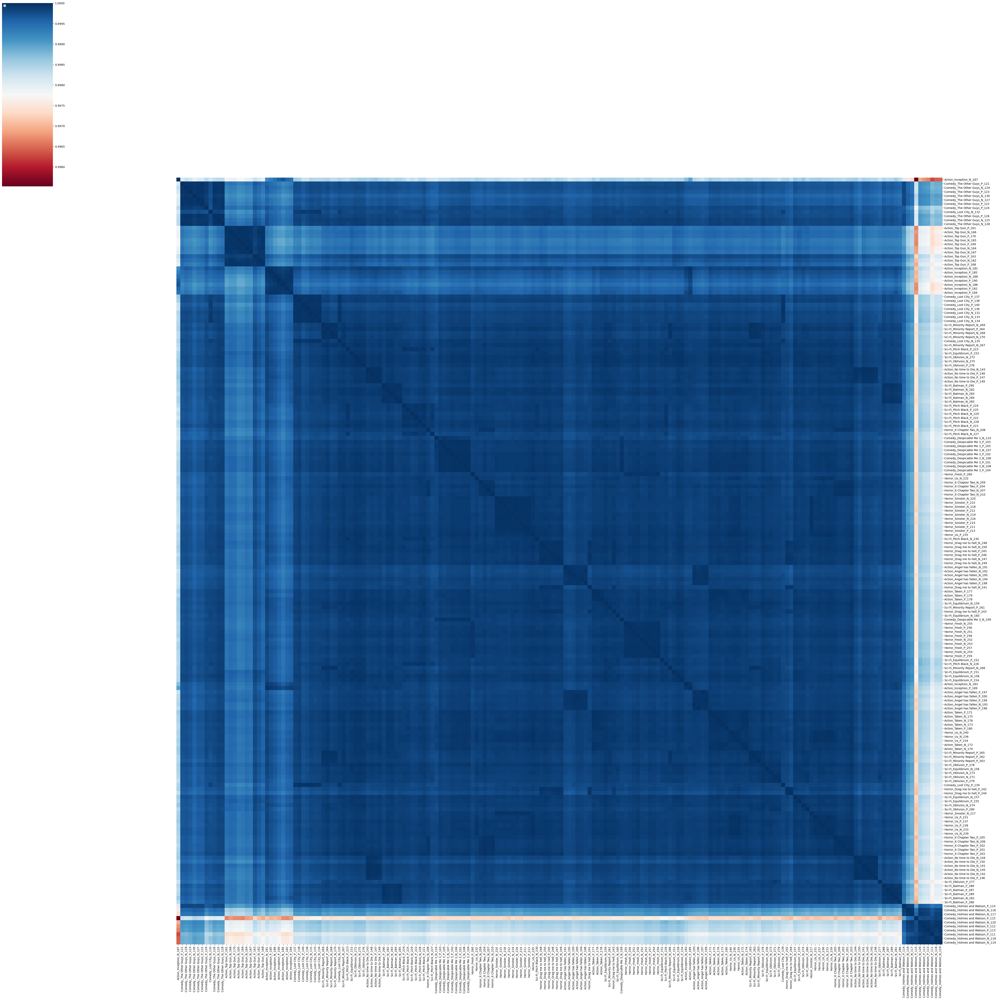

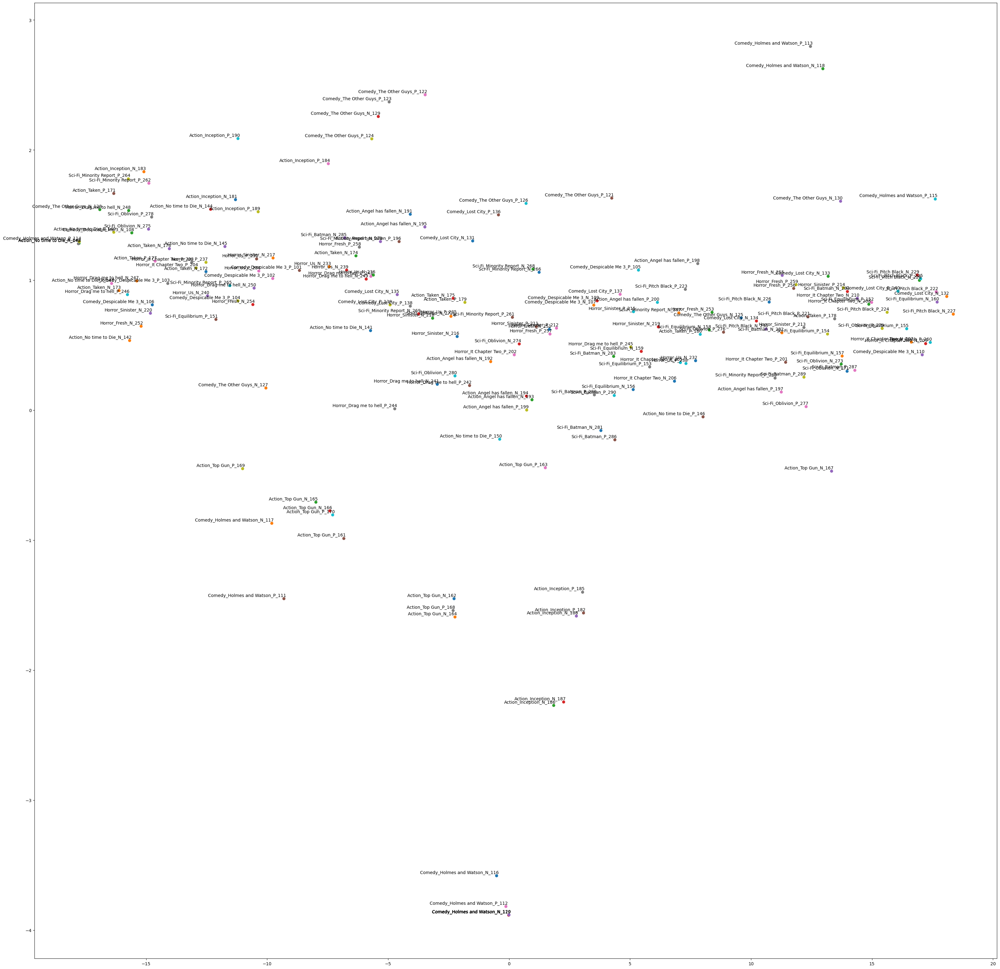

In [66]:
run_doc2vec_experiment(documents, clean_method2, 300, 'Doc2Vec_m2_e300')

## 7.3 Doc2Vec Cleaning Method 3

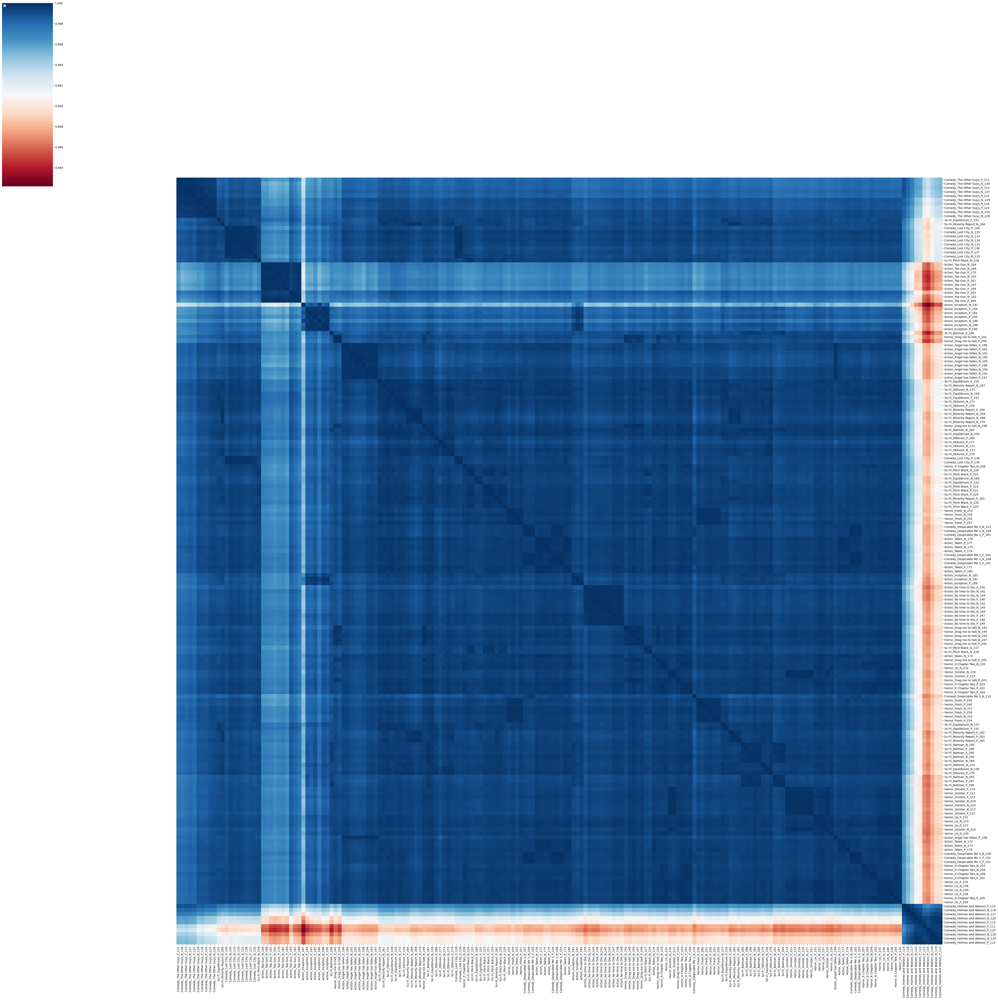

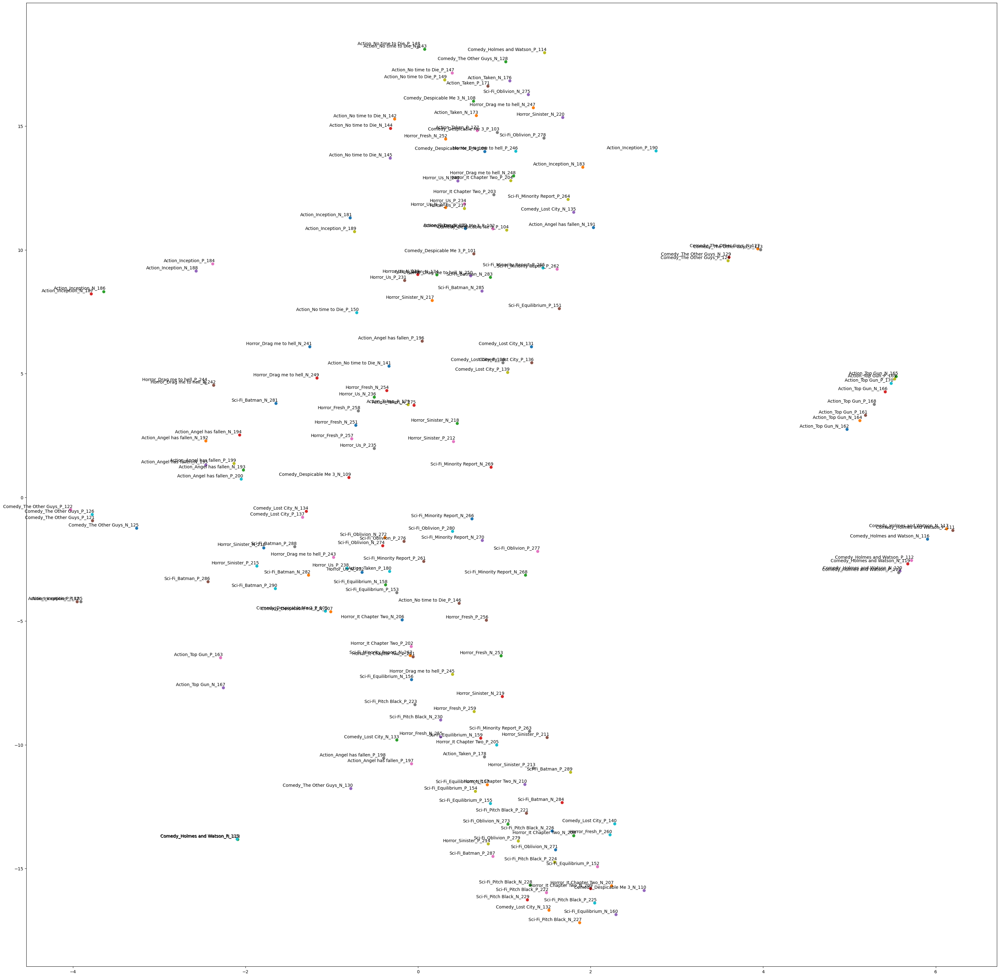

In [67]:
run_doc2vec_experiment(documents, clean_method3, 100, 'Doc2Vec_m3_e100')

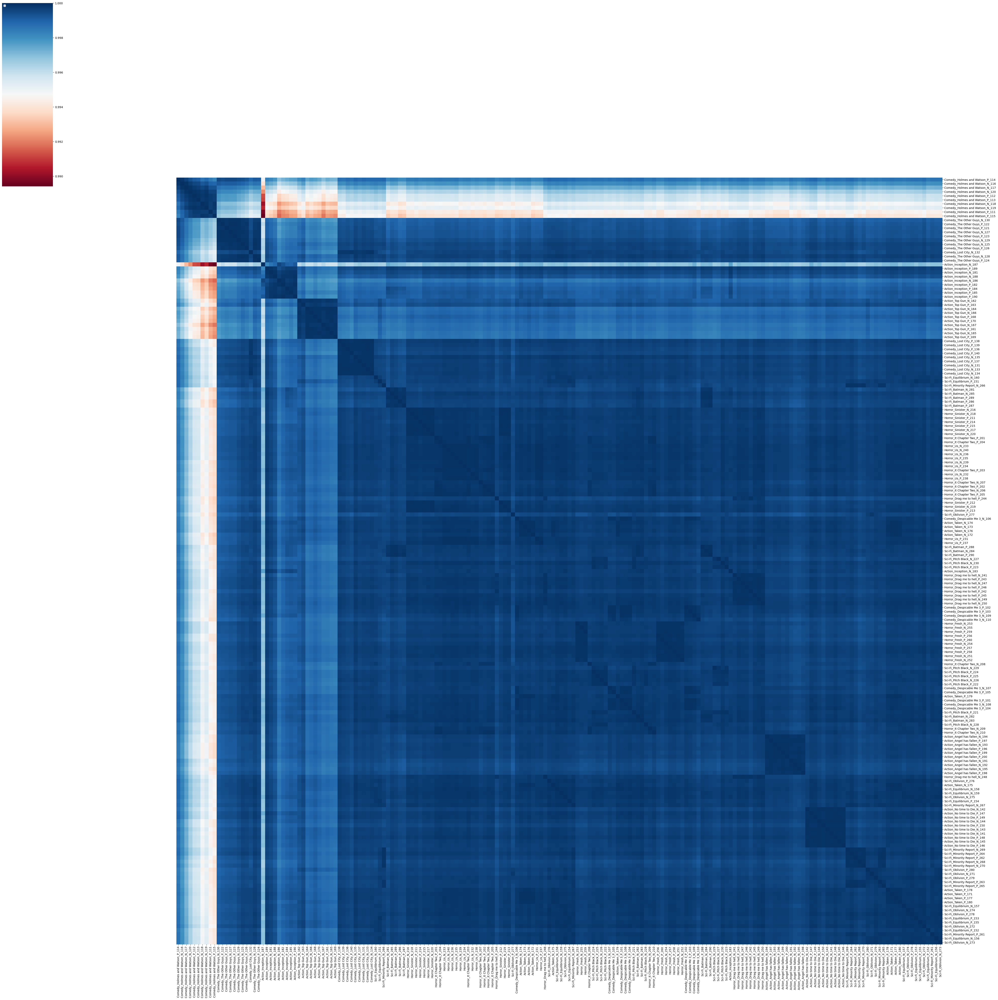

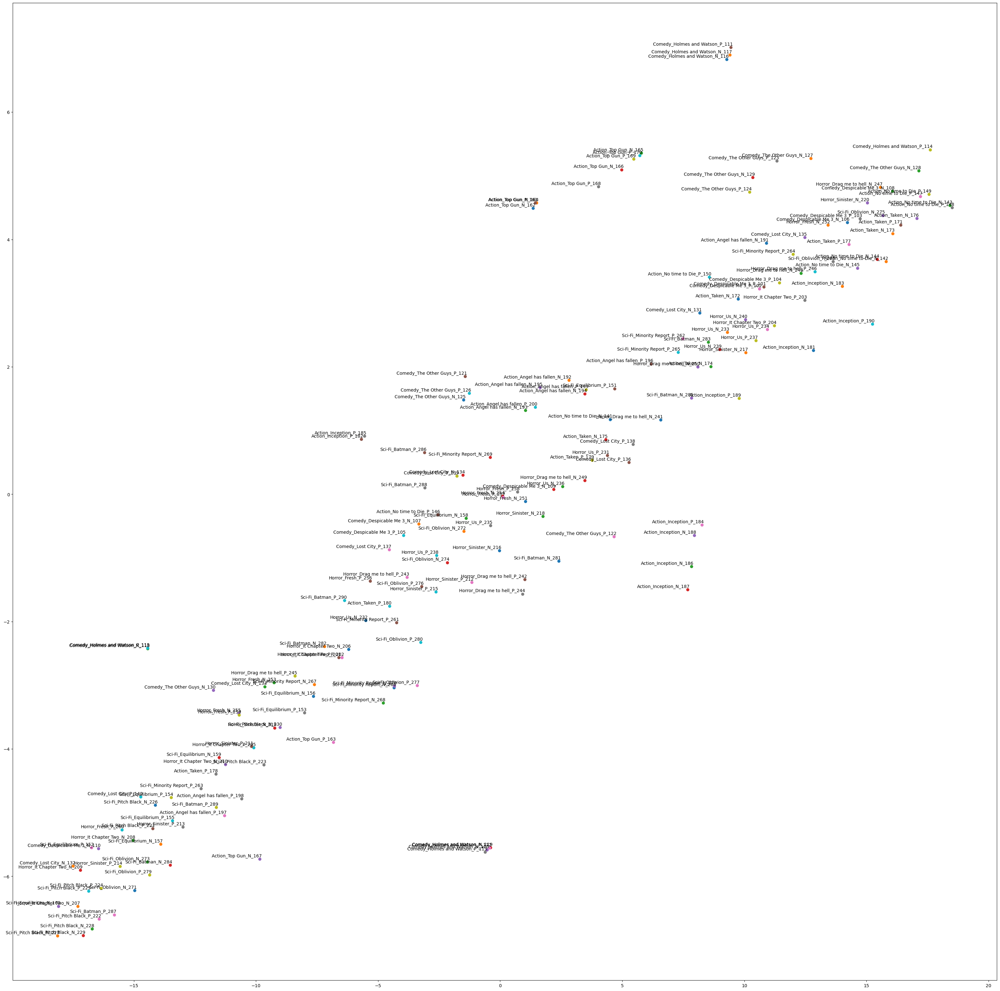

In [68]:
run_doc2vec_experiment(documents, clean_method3, 200, 'Doc2Vec_m3_e200')

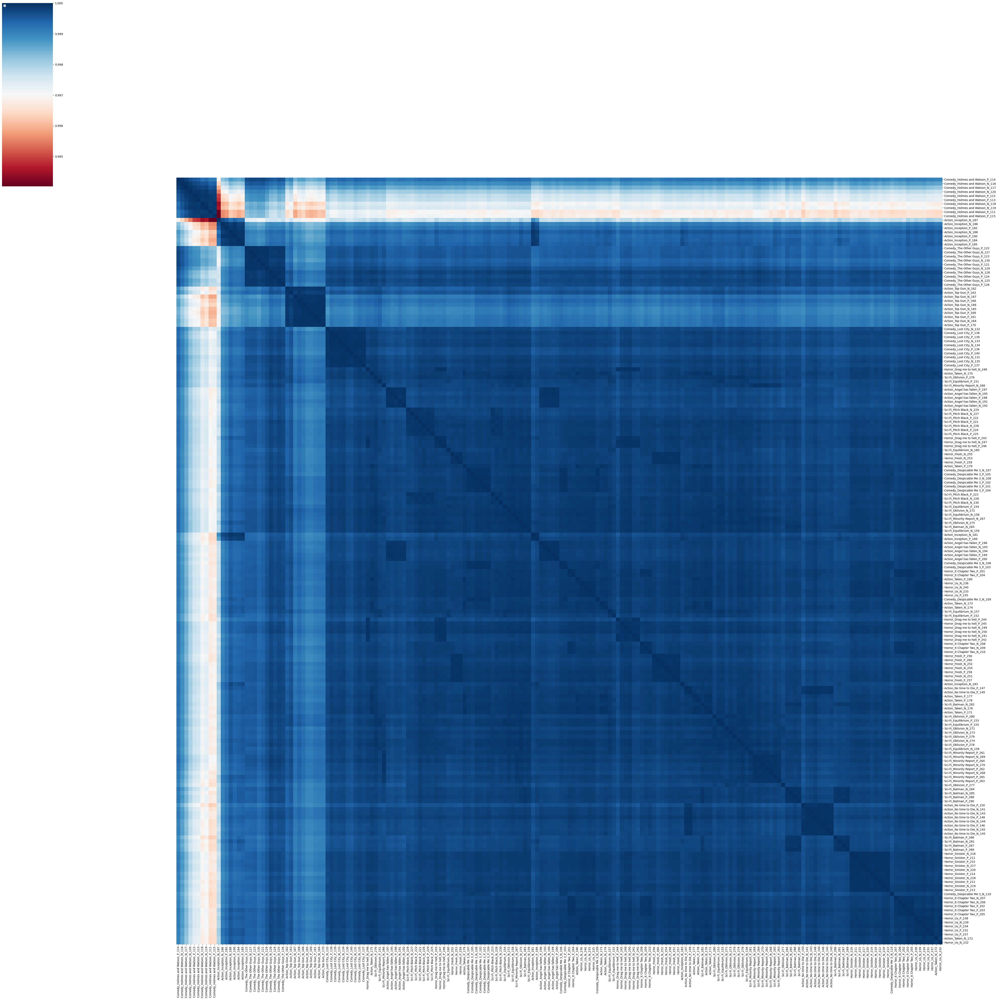

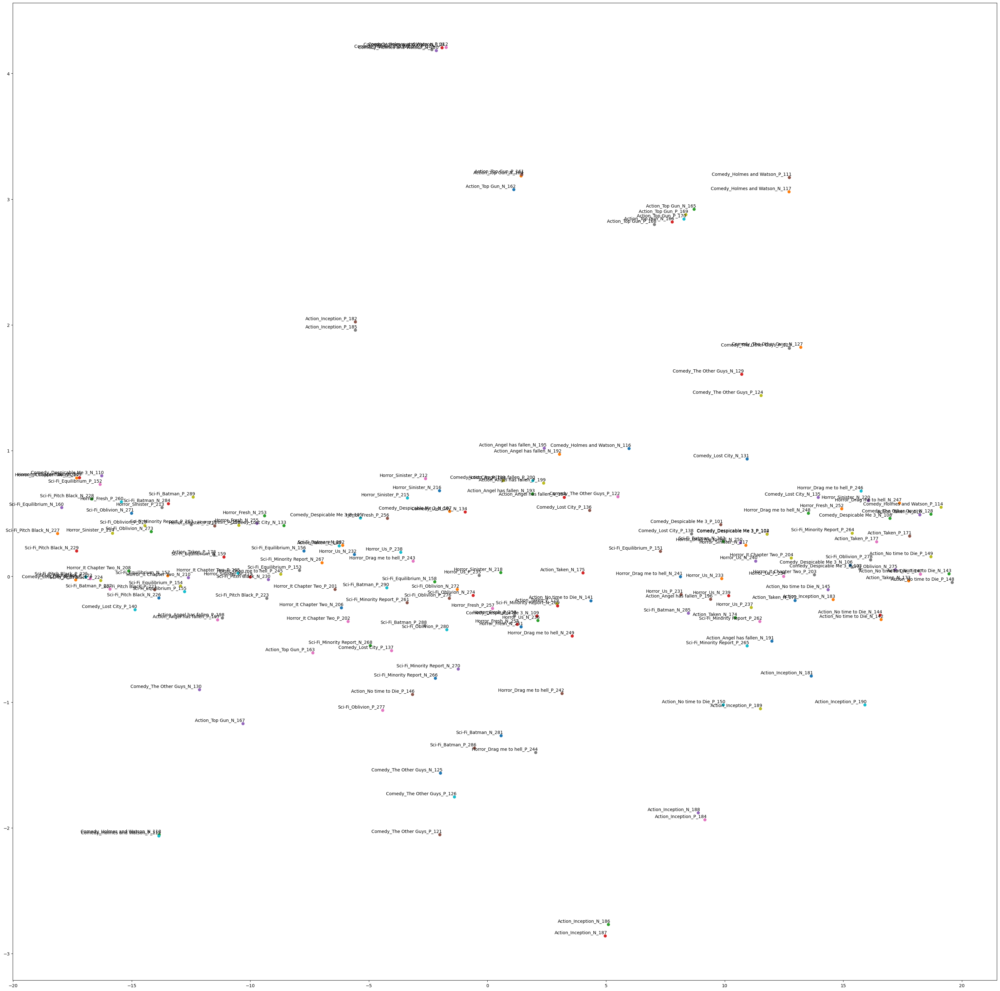

In [69]:
run_doc2vec_experiment(documents, clean_method3, 300, 'Doc2Vec_m3_e300')